In [11]:
import json
import numpy as np
import xobjects as xo
import xtrack as xt
import xpart as xp
from tqdm import tqdm
import matplotlib.pyplot as plt
from scipy import constants 
####################
# Choose a context #
####################
context = xo.ContextCpu()
# context = xo.ContextCpu(omp_num_threads='auto')
buf = context.new_buffer()

# Ion properties:
m_u = 931.49410242e6 # eV/c^2 -- atomic mass unit
A = 207.98 # Lead-208
Z = 82  # Number of protons in the ion (Lead)
Ne = 3 # Number of remaining electrons (Lithium-like)
m_e = 0.511e6 # eV/c^2 -- electron mass
m_p = 938.272088e6 # eV/c^2 -- proton mass
c = 299792458.0 # m/s

m_ion = A*m_u + Ne*m_e # eV/c^2
equiv_proton_momentum = 236e9 # eV/c = gamma_p*m_p*v
gamma_p = np.sqrt( 1 + (equiv_proton_momentum/m_p)**2 ) # equvalent gamma for protons in the ring

p0c = equiv_proton_momentum*(Z-Ne) # eV/c
gamma = np.sqrt( 1 + (p0c/m_ion)**2 ) # ion relativistic factor
beta = np.sqrt(1-1/(gamma*gamma)) # ion beta


In [12]:
#%%
##################
# Build TrackJob #
##################

fname_sequence ='/home/pkruyt/cernbox/xsuite-env/xtrack/test_data/sps_w_spacecharge/line_no_spacecharge_and_particle.json'

with open(fname_sequence, 'r') as fid:
     input_data = json.load(fid)
sequence = xt.Line.from_dict(input_data['line'])

n_part = int(1e2)

SPS_tracker = xt.Tracker(_context=context, _buffer=buf, line=sequence)

# Build a reference particle
particle_sample = xp.Particles(mass0=m_ion, q0=Z-Ne, p0c=p0c)

sigma_z = 22.5e-2
nemitt_x = 2e-6
nemitt_y = 2.5e-6


particles = xp.generate_matched_gaussian_bunch(
         num_particles=n_part,
         #total_intensity_particles=bunch_intensity,
         nemitt_x=nemitt_x, nemitt_y=nemitt_y, sigma_z=sigma_z,
         #R_matrix=r_matrix,
         particle_ref=particle_sample,
         tracker=SPS_tracker
         #,steps_r_matrix=steps_r_matrix
         )


sequence.particle_ref = particle_sample
twiss = sequence.twiss(symplectify=True)

twiss_dict=dict(twiss)

#%%
###################
# Linear Transfer #
###################

arc=xt.LinearTransferMatrix(Q_x=twiss['qx'], Q_y=twiss['qy'],
beta_x_0=twiss['betx'][0], beta_x_1=twiss['betx'][-1],
beta_y_0=twiss['bety'][0], beta_y_1=twiss['bety'][-1],
alpha_x_0=twiss['alfx'][0], alpha_x_1=twiss['alfx'][-1],
alpha_y_0=twiss['alfy'][0], alpha_y_1=twiss['alfy'][-1],
disp_x_0=twiss['dx'][0], disp_x_1=twiss['dx'][-1],
disp_y_0=twiss['dy'][0], disp_y_1=twiss['dy'][-1],
beta_s=twiss['betz0'],
Q_s=-twiss['qs'],
chroma_x=twiss['dqx'], chroma_y=twiss['dqy'])

SPS_lin = xt.Line()

SPS_lin.append_element(arc,'SPS_LinearTransferMatrix') 

Done loading line from dict.           
Compiling ContextCpu kernels...
Done compiling ContextCpu kernels.
The argument tracker is deprecated. Please use line instead. <class 'DeprecationWarning'>
*** Maximum RMS bunch length 0.23592919520901076m.
... distance to target bunch length: -2.2500e-01
... distance to target bunch length: 4.4112e-03
... distance to target bunch length: 4.1449e-03
... distance to target bunch length: -3.3479e-03
... distance to target bunch length: 1.0467e-03
... distance to target bunch length: 2.0728e-04
... distance to target bunch length: -3.3833e-06
... distance to target bunch length: 4.9353e-08
... distance to target bunch length: -6.5924e-08
--> Bunch length: 0.2250000493531224
--> Emittance: 0.6606168164388687
Warning! scale_with_transverse_norm_emitt is deprecated. Use nemitt_x and nemitt_y instead.


In [13]:
##################
# Laser Cooler #
##################

sigma_dp = 2e-4 # relative ion momentum spread
#sigma_dp = std_delta # relative ion momentum spread


#laser-ion beam collision angle
theta_l = 2.6*np.pi/180 # rad
theta_l = 0
nx = 0; ny = -np.sin(theta_l); nz = -np.cos(theta_l)

# Ion excitation energy:
hw0 = 230.823 # eV
hc=constants.hbar*c/constants.e # eV*m (ħc)
lambda_0 = 2*np.pi*hc/hw0 # m -- ion excitation wavelength

lambda_l = lambda_0*gamma*(1 + beta*np.cos(theta_l)) # m -- laser wavelength

# Shift laser wavelength for fast longitudinal cooling:
lambda_l = lambda_l*(1+1*sigma_dp) # m

laser_frequency = c/lambda_l # Hz
sigma_w = 2*np.pi*laser_frequency*sigma_dp
#sigma_w = 2*np.pi*laser_frequency*sigma_dp/2 # for fast longitudinal cooling


sigma_t = 1/sigma_w # sec -- Fourier-limited laser pulse
print('Laser pulse duration sigma_t = %.2f ps' % (sigma_t/1e-12))

print('Laser wavelength = %.2f nm' % (lambda_l/1e-9))

laser_waist_radius = 1.3e-3
#laser_waist_radius = 1.3e-7

laser_x=0.0020000
laser_x=0.000000

GF_IP = xt.IonLaserIP(_buffer=buf,
                      laser_x=laser_x,
                      laser_y=0,
                      laser_z=10e-3,
                      
                      laser_direction_nx = 0,
                      laser_direction_ny = 0,
                      laser_direction_nz = -1,
                      laser_energy         = 5e-3, # J
                      laser_duration_sigma = sigma_t, # sec
                      laser_wavelength = lambda_l, # m
                      laser_waist_radius = laser_waist_radius, # m
                      ion_excitation_energy = hw0, # eV
                      ion_excited_lifetime  = 76.6e-12, # sec
                          
   )
                          
   
SPS_lin.append_element(GF_IP, 'GammaFactory_IP')



Laser pulse duration sigma_t = 2.74 ps
Laser wavelength = 1034.07 nm


In [14]:
##################
# Tracking #
##################
x, px, delta, action_x = [], [], [], []
num_turns = int(1e4)
# loop over turns
for i in tqdm(range(num_turns)):
    
    x.append(particles.x)
    px.append(particles.px)
    delta.append(particles.delta)
    
    # track particle
    arc.track(particles)
    GF_IP.track(particles)

  0%|          | 0/10000 [00:00<?, ?it/s]

Compiling ContextCpu kernels...


b8422ddb6bc0441cbd919f30570fd417.c: In function ‘IonLaserIP_track_local_particle’:
b8422ddb6bc0441cbd919f30570fd417.c:3354:12: warning: unused variable ‘beta0’ [-Wunused-variable]
     double beta0  = sqrt(1.0 - 1.0/(gamma0*gamma0));
            ^~~~~
  1%|          | 86/10000 [00:02<03:21, 49.18it/s] 

Done compiling ContextCpu kernels.
I = 64446078387437888.000000
I = 552451062514126336.000000
I = 5941152527013562368.000000
I = 1646735312734115584.000000
I = 425932768653978816.000000
I = 1159094518220327936.000000
I = 1978854132663081216.000000
I = 874428080823869.500000
I = 12950636786494.828125
I = 1417539653857954048.000000
I = 510002431434864640.000000
I = 6509147573560168448.000000
I = 9405947877632966656.000000
I = 500138710510478080.000000
I = 36729007566551568.000000
I = 1927653214802371584.000000
I = 2071105919702133504.000000
I = 3876727821531947008.000000
I = 596288290473833216.000000
I = 133495060653580624.000000
I = 6711891390816163840.000000
I = 290984659518202944.000000
I = 395242290500266624.000000
I = 205643500561668736.000000
I = 12178323982901374.000000
I = 4941178742340741120.000000
I = 243426770642000448.000000
I = 48452700376709080.000000
I = 2414046024501124608.000000
I = 2918922416891869696.000000
I = 2996182596431845376.000000
I = 1549880641334858496.000000


  2%|▏         | 161/10000 [00:02<01:38, 99.95it/s]

I = 34685590717681764.000000
I = 7042468650653977600.000000
I = 297508213832252224.000000
I = 680195626116486528.000000
I = 24844264659481388.000000
I = 2456497095165301760.000000
I = 2740003001454467584.000000
I = 120248547843248016.000000
I = 382593804172452032.000000
I = 402870260205698176.000000
I = 250721704333208032.000000
I = 1349748760871.161621
I = 8851788094526354432.000000
I = 3020447848241430528.000000
I = 11678273642597552.000000
I = 1994757871556953.250000
I = 15313805151550444.000000
I = 440325274936480512.000000
I = 7872497306492180480.000000
I = 3568529023261297.000000
I = 5118181886709625856.000000
I = 177811417346791072.000000
I = 648635316508146688.000000
I = 54217338534894.218750
I = 2257423212456736512.000000
I = 630635487837297408.000000
I = 25433099272264144.000000
I = 3392927274968823296.000000
I = 1737175894480034560.000000
I = 817218279916219.125000
I = 1329075103561812992.000000
I = 14465237660904170.000000
I = 63586428940057304.000000
I = 465296255196853964

  3%|▎         | 288/10000 [00:02<00:50, 190.73it/s]

I = 915707325283931008.000000
I = 5447794509884866560.000000
I = 5039715039392452608.000000
I = 2635700080908655616.000000
I = 830649748567834624.000000
I = 2491402111066500096.000000
I = 5230380198588876800.000000
I = 53693316761605544.000000
I = 273925446985205856.000000
I = 11199462102346686.000000
I = 301081807859038080.000000
I = 2162960682352835072.000000
I = 860737289098224384.000000
I = 1797708554251507968.000000
I = 8759993280836102144.000000
I = 1913801226161311232.000000
I = 4468882425868728832.000000
I = 57549894351636312.000000
I = 5420391301987620864.000000
I = 21086007040385632.000000
I = 1683888041313648640.000000
I = 4984871394483518464.000000
I = 22356493545392532.000000
I = 1562879150481693696.000000
I = 5272807576821180416.000000
I = 1638153358870953728.000000
I = 4772121039790693376.000000
I = 7377348263764656128.000000
I = 2733331349206905856.000000
I = 898779228324551680.000000
I = 1304586645337651712.000000
I = 404519642877192512.000000
I = 8696641387738226688.0

  4%|▍         | 425/10000 [00:03<00:31, 306.50it/s]

I = 916362327575870208.000000
I = 6968371829562606592.000000
I = 5928912928982046720.000000
I = 596497986810522752.000000
I = 1072703432836630784.000000
I = 1753786507987930368.000000
I = 63601667943036496.000000
I = 9129195213451811840.000000
I = 1328509225828578048.000000
I = 129479444255746.062500
I = 702285341899980.625000
I = 27968695349395.082031
I = 8769803362810946560.000000
I = 1107580839370064768.000000
I = 760081546673113728.000000
I = 3325371239970125312.000000
I = 729591193426002688.000000
I = 893596962632568448.000000
I = 1994241384555401216.000000
I = 101660902007443984.000000
I = 5472328916991266816.000000
I = 1743597763513918464.000000
I = 1469393669072967680.000000
I = 2452720465514003456.000000
I = 8310177751476510.000000
I = 27195919171495944.000000
I = 9422911532202993664.000000
I = 1125104116330535808.000000
I = 482889871227452096.000000
I = 3921389786541241344.000000
I = 3783529659510674944.000000
I = 676520738498373376.000000
I = 194431308936573440.000000
I = 21

  6%|▌         | 568/10000 [00:03<00:21, 442.60it/s]

I = 2160807989277256192.000000
I = 3319594384111607808.000000
I = 4605771995392662016.000000
I = 7335444228871531520.000000
I = 9469918822123362304.000000
I = 513125867930606976.000000
I = 5201573597477411840.000000
I = 36421875090811552.000000
I = 282027374380782016.000000
I = 2914287745061925376.000000
I = 26754500795677884.000000
I = 88318809340439888.000000
I = 3704068754340551168.000000
I = 236899317722590176.000000
I = 579801925608456192.000000
I = 6826998144627675136.000000
I = 250310225886354528.000000
I = 9967728845171476480.000000
I = 341340773544486464.000000
I = 97785661156077760.000000
I = 705010718379938816.000000
I = 138344397671540144.000000
I = 2708441754321794560.000000
I = 1639097311274980096.000000
I = 1187277740814959616.000000
I = 1056508452634963072.000000
I = 189724612590727936.000000
I = 332952756313251.187500
I = 573073700840295232.000000
I = 161137644602806848.000000
I = 1334396295242273024.000000
I = 7370541148413787136.000000
I = 27541977880003352.000000
I 

  8%|▊         | 750/10000 [00:03<00:16, 550.38it/s]

I = 4285852930014159360.000000
I = 8006029563123351552.000000
I = 2233711279765427200.000000
I = 386541676499604928.000000
I = 1378869784558039552.000000
I = 454940217825378560.000000
I = 8663446015238301696.000000
I = 177755600437084736.000000
I = 364972590767994752.000000
I = 1210378845743263744.000000
I = 2126961755218509056.000000
I = 3436439312308489728.000000
I = 33443104087436528.000000
I = 1051829526161172736.000000
I = 50121632646859936.000000
I = 3853935238146481152.000000
I = 3870442579228150272.000000
I = 7070645736200797184.000000
I = 6549156638203464704.000000
I = 3046636833277758976.000000
I = 240070207376.736450
I = 1136398971661939072.000000
I = 7309211124358140928.000000
I = 2787255072932686848.000000
I = 787985551198230272.000000
I = 2938017132253575168.000000
I = 1504322856637940992.000000
I = 3747128895908771328.000000
I = 1743349781064350464.000000
I = 19228686274779912.000000
I = 3856469096159067648.000000
I = 54293623378296776.000000
I = 125724319430853712.00000

  8%|▊         | 814/10000 [00:03<00:19, 469.16it/s]

I = 1035700492457620864.000000
I = 747733697028353280.000000
I = 2055597251700561152.000000
I = 534460816647090496.000000
I = 44543687291121216.000000
I = 1386836592918586624.000000
I = 506799011239705984.000000
I = 1993772014048107008.000000
I = 3296906369459584512.000000
I = 5387787130561954816.000000
I = 6280970019955108864.000000
I = 8782795839193203712.000000
I = 503626537922239936.000000
I = 4495563925249794560.000000
I = 25467941532046620.000000
I = 274809085299649824.000000
I = 2278795425341940992.000000
I = 37857894735572400.000000
I = 320220773190958016.000000
I = 1159989154429987328.000000
I = 631490800280388736.000000
I = 986163816755754624.000000
I = 5888013248028488704.000000
I = 299425326421039104.000000
I = 9814127621509969920.000000
I = 229383811648141280.000000
I = 99560252853405008.000000
I = 995031982738520192.000000
I = 15022161474822644.000000
I = 2872059714633298432.000000
I = 1646777024256373248.000000
I = 451855510415859776.000000
I = 1384097150329655808.000000

 10%|▉         | 959/10000 [00:03<00:16, 533.48it/s]

I = 3909445063893510144.000000
I = 174293602009121632.000000
I = 2015721225406572288.000000
I = 1702845418987372032.000000
I = 445109858313075200.000000
I = 621698438406864128.000000
I = 759655219310240640.000000
I = 1004941193493302400.000000
I = 3630821244036739072.000000
I = 7797958007551256576.000000
I = 3232307528158842368.000000
I = 1465994109987093760.000000
I = 1037982848157453568.000000
I = 749272401704366208.000000
I = 201526325441028576.000000
I = 5087018094605665280.000000
I = 634496244349768960.000000
I = 1088145805332716416.000000
I = 1955696155171730176.000000
I = 5988686082001547264.000000
I = 26556978499563932.000000
I = 10097537575815333888.000000
I = 787149983589970944.000000
I = 1147979661609847424.000000
I = 3891916524931817984.000000
I = 3682151870023179264.000000
I = 9016995743237448704.000000
I = 5082346230165045248.000000
I = 41829922217669.671875
I = 2525164134422351872.000000
I = 1687003162332438784.000000
I = 1080860138939419136.000000
I = 193232687656007808

 11%|█▏        | 1135/10000 [00:04<00:13, 642.18it/s]

I = 2172990753582760704.000000
I = 75808276316282768.000000
I = 8954155658184420352.000000
I = 2778105860418495488.000000
I = 2295420470877365504.000000
I = 75732638045704000.000000
I = 1303841014705796864.000000
I = 937766210732291.875000
I = 2747014709265890.500000
I = 6208800579860878.000000
I = 4935364331236644864.000000
I = 348698916351206656.000000
I = 6952506183729032192.000000
I = 280702368781696512.000000
I = 2086910639998442240.000000
I = 5029594265154605056.000000
I = 2157452925779190528.000000
I = 860023187494708736.000000
I = 1919627578924666880.000000
I = 1490554262288367104.000000
I = 3093326955684425728.000000
I = 1689477947397292288.000000
I = 2009227752501565.750000
I = 198435826986790720.000000
I = 6222003072284539904.000000
I = 767383496070728192.000000
I = 2125334640344513536.000000
I = 705285273258444.750000
I = 6439360324760179712.000000
I = 1238889361804179712.000000
I = 3542345540875266048.000000
I = 486836754863326336.000000
I = 422258991543367552.000000
I = 1

 13%|█▎        | 1286/10000 [00:04<00:14, 612.71it/s]

I = 3027046769919050240.000000
I = 3312620523641601536.000000
I = 3401578343191714304.000000
I = 9522999528006090752.000000
I = 4817587275849841664.000000
I = 7825315894981319.000000
I = 4682241500783005696.000000
I = 1334106992087466752.000000
I = 7627570048374423552.000000
I = 7417914650291137.000000
I = 1285108720135830528.000000
I = 1331167457396289280.000000
I = 438263189162582080.000000
I = 97682448180823840.000000
I = 1844186866377401856.000000
I = 34878173860720356.000000
I = 98681402476988656.000000
I = 6813521517320.956055
I = 8382934491220339712.000000
I = 1732809668090684672.000000
I = 2177598063096918272.000000
I = 44498083156474272.000000
I = 2366890174039527936.000000
I = 9218385409199590400.000000
I = 270614996776644480.000000
I = 6479108990152949760.000000
I = 2472831214203846656.000000
I = 780178769869818496.000000
I = 5109205111695862784.000000
I = 923214338378058752.000000
I = 627490485965284.125000
I = 64729346306415024.000000
I = 9562150796894720000.000000
I = 809

 14%|█▎        | 1350/10000 [00:04<00:17, 504.88it/s]

I = 2390719264277607424.000000
I = 4761917332891149312.000000
I = 5686028364074840064.000000
I = 9380379555038803968.000000
I = 6211724798142333952.000000
I = 328154318853640576.000000
I = 9857326371810422784.000000
I = 2097686278921403904.000000
I = 45295971235314040.000000
I = 1620816703882767616.000000
I = 114934274568451856.000000
I = 2708032991817170432.000000
I = 5704881240475631616.000000
I = 143943040714928704.000000
I = 373156550066962560.000000
I = 184080650382204064.000000
I = 881288106088601728.000000
I = 9830987313361616896.000000
I = 3453220489258395648.000000
I = 96935273935368752.000000
I = 707175618681755648.000000
I = 278386900506.797607
I = 1755764257788486400.000000
I = 4093832912853017600.000000
I = 1205038882865534720.000000
I = 733881300405290624.000000
I = 7817920242527620096.000000
I = 201046692022629728.000000
I = 1949657011827843072.000000
I = 458615347687357376.000000
I = 300073775393721408.000000
I = 7973710040219805696.000000
I = 91824576883708240.000000
I

 15%|█▍        | 1472/10000 [00:04<00:16, 510.07it/s]

I = 913913441123903104.000000
I = 1795518706381515.250000
I = 6882212409034840064.000000
I = 2819450641741470720.000000
I = 24020071923704320.000000
I = 2087311613790717184.000000
I = 41269703830228704.000000
I = 1033598909205753344.000000
I = 2129052641479159552.000000
I = 1563694083404885.250000
I = 10565003747639880.000000
I = 902929084195704.875000
I = 9449647127305979904.000000
I = 3666716033147122176.000000
I = 110839338155594640.000000
I = 8345536877392516096.000000
I = 934211509687095680.000000
I = 104661990900887136.000000
I = 402687567922625472.000000
I = 1818734393084394.250000
I = 1628405631507695872.000000
I = 2041941163660971776.000000
I = 1316186056864603648.000000
I = 5698061527009612800.000000
I = 1611988162802524160.000000
I = 52545531960113168.000000
I = 8586006831900895232.000000
I = 443305699169704064.000000
I = 1020989361482213632.000000
I = 8209500409629166592.000000
I = 1996598867848848896.000000
I = 1742758044168857600.000000
I = 1097652250649566.750000
I = 472

 16%|█▌        | 1623/10000 [00:05<00:14, 579.06it/s]

000000
I = 180001319972055168.000000
I = 2951234229670874.000000
I = 1940207740842877440.000000
I = 431338572263009600.000000
I = 88648380312477.734375
I = 386741170291668416.000000
I = 7621535329904173056.000000
I = 9837118140943188.000000
I = 76501095757380976.000000
I = 1467676140925835264.000000
I = 9797758061637246976.000000
I = 43391653886244824.000000
I = 45755967517287168.000000
I = 299785869052153088.000000
I = 2104704614288975.500000
I = 677557527844728448.000000
I = 1457344085234503168.000000
I = 1860507655028919040.000000
I = 992314995842227456.000000
I = 4900198475007671.000000
I = 1822785451943931.250000
I = 2533708689764166144.000000
I = 2042194512699920896.000000
I = 2092669214072537344.000000
I = 9765707513500928000.000000
I = 7550435483583718400.000000
I = 427468256179676352.000000
I = 4729674580092680192.000000
I = 2542300189753202688.000000
I = 3834919482431505920.000000
I = 7157229597371511808.000000
I = 1482262588901798.250000
I = 5980239139690682368.000000
I = 29

 18%|█▊        | 1756/10000 [00:05<00:15, 548.16it/s]

I = 873420573045164800.000000
I = 188712253247756832.000000
I = 2455847680638408704.000000
I = 898574588378846080.000000
I = 3916486787871218176.000000
I = 2712997289205175808.000000
I = 3751003744273588736.000000
I = 3016393092339527680.000000
I = 5943893751145719808.000000
I = 2156089851275940352.000000
I = 285600107465860640.000000
I = 6417410380557268.000000
I = 45915153050622152.000000
I = 1662203958165988864.000000
I = 150620854965752544.000000
I = 592383501676086.500000
I = 879745721396342400.000000
I = 5025019928825336832.000000
I = 160183646651357056.000000
I = 6039343240745346048.000000
I = 385961825991665536.000000
I = 9783847900576014336.000000
I = 31961371431514376.000000
I = 64448625161714152.000000
I = 229579395739630080.000000
I = 7497004116992400384.000000
I = 1717429003451452416.000000
I = 877023380449124992.000000
I = 940490708736422656.000000
I = 2165375382244502272.000000
I = 537187878356321.687500
I = 22081984620516.363281
I = 1288194169913105920.000000
I = 512430

 18%|█▊        | 1812/10000 [00:05<00:16, 489.07it/s]

I = 3868442768704003072.000000
I = 743619315884788224.000000
I = 3921398683445242368.000000
I = 1327613982321028096.000000
I = 5905351518195.317383
I = 811097194369989760.000000
I = 2761756533711987200.000000
I = 1498571994856233472.000000
I = 1419355023319236608.000000
I = 37799237312351632.000000
I = 2895082364739806208.000000
I = 8023732263541995520.000000
I = 8286363941499579392.000000
I = 128352498969380528.000000
I = 4733183741177387008.000000
I = 820220635177578496.000000
I = 35182805365013816.000000
I = 8832617169222616064.000000
I = 2448121831290437120.000000
I = 3893435723259873792.000000
I = 492901833544945856.000000
I = 2128116096344644.250000
I = 6284965877299536896.000000
I = 4315987592693332.000000
I = 370271239362006464.000000
I = 34199086127200632.000000
I = 5739768528418130944.000000
I = 3386418297616501248.000000
I = 3790203524492959744.000000
I = 2085617259927437312.000000
I = 111690250196504.953125
I = 1437227519099740928.000000
I = 8638595606159403008.000000
I = 8

 19%|█▉        | 1913/10000 [00:05<00:16, 490.66it/s]

4672528054272.000000
I = 3945196756067700224.000000
I = 1136634031466104192.000000
I = 75931180067640.656250
I = 633627840690428160.000000
I = 5066853030906950656.000000
I = 3576505729419830272.000000
I = 2633443947386115072.000000
I = 3740184976467851.500000
I = 299346276517445760.000000
I = 7144305534040036352.000000
I = 9702333224087728128.000000
I = 223391043708764224.000000
I = 5900835624833680384.000000
I = 871723549113898240.000000
I = 52024808065241672.000000
I = 6759855156548974592.000000
I = 2960775012003543552.000000
I = 3974422954170463232.000000
I = 533699242826189952.000000
I = 3221097362128202.000000
I = 5548877835162086400.000000
I = 6172412520613784.000000
I = 209777783828979392.000000
I = 187944466271309120.000000
I = 5550084439863550976.000000
I = 8015882497471485952.000000
I = 3044601495853091840.000000
I = 3614187129004163072.000000
I = 67816285114740.742188
I = 350251963113896768.000000
I = 7577291890900238336.000000
I = 84252892240495248.000000
I = 83338617800356

 20%|██        | 2024/10000 [00:05<00:15, 517.22it/s]

284523145728.000000
I = 126997514277062512.000000
I = 18498708440958072.000000
I = 41545829927066728.000000
I = 441862286425139904.000000
I = 1470833753209659904.000000
I = 2020324648471419136.000000
I = 1076661036833109248.000000
I = 1054663187114610944.000000
I = 455584979544291584.000000
I = 7532043405538171904.000000
I = 148158025520554.718750
I = 2088427555953028352.000000
I = 23004004152158672.000000
I = 1718485226205968384.000000
I = 3843418572062257664.000000
I = 1926260301212103.000000
I = 7865292486222221312.000000
I = 9307407367892041728.000000
I = 4953946600415989760.000000
I = 5413029479119406080.000000
I = 4914878014282548224.000000
I = 5027893852673729536.000000
I = 2671169246007716352.000000
I = 931351627784453632.000000
I = 1896578119765578752.000000
I = 4277071078814537216.000000
I = 1851691489874337.250000
I = 2211096826548411904.000000
I = 348012267068344832.000000
I = 108366257318470448.000000
I = 3506493653418461696.000000
I = 1066977596543799168.000000
I = 378106

 22%|██▏       | 2171/10000 [00:06<00:13, 592.25it/s]

I = 719628857891607936.000000
I = 22845537216940424.000000
I = 1728479267467454464.000000
I = 8359507404224070656.000000
I = 2697636323716773888.000000
I = 452624724890603776.000000
I = 1455945385387171.250000
I = 1349387148543906816.000000
I = 3397279518419041280.000000
I = 169744037607652864.000000
I = 2349352729464295424.000000
I = 282516589863953728.000000
I = 2395238475483972608.000000
I = 20903737.775519
I = 6532714618317021184.000000
I = 1567321910949481472.000000
I = 90009491189902800.000000
I = 7788807292542261.000000
I = 468206604722593984.000000
I = 408659165464315584.000000
I = 9514764007576879104.000000
I = 40287668177741200.000000
I = 3432948842401783808.000000
I = 39638158653323944.000000
I = 2743126297741323264.000000
I = 3016917430558.727539
I = 9647917076778973184.000000
I = 40498253251403304.000000
I = 6325219672766523.000000
I = 1591921838368770304.000000
I = 123619003155082048.000000
I = 5145812063303829.000000
I = 7517401146616323072.000000
I = 667105851883435136.

 22%|██▏       | 2231/10000 [00:06<00:17, 434.25it/s]

I = 3027172590509459968.000000
I = 9626741268126852.000000
I = 36897082144737752.000000
I = 9475081112003682304.000000
I = 1532822331983431424.000000
I = 542644578019912640.000000
I = 4615220965156467712.000000
I = 3082618897132924928.000000
I = 539319462483131712.000000
I = 224334236162667360.000000
I = 1860795557907195648.000000
I = 592431784052787584.000000
I = 2245126782506542080.000000
I = 3368005349234784256.000000
I = 4425724049290754560.000000
I = 6707884823725901824.000000
I = 9740730441887127552.000000
I = 834198077122294656.000000
I = 2114276237462758400.000000
I = 71443179434245536.000000
I = 273729684329912768.000000
I = 2779077931463242752.000000
I = 108784761095790256.000000
I = 31916951071980852.000000
I = 2612890385321088000.000000
I = 135600760288805280.000000
I = 795183282428207360.000000
I = 7885160319705324544.000000
I = 404017247753839872.000000
I = 9906270470143946752.000000
I = 181310173150565888.000000
I = 101161644868808960.000000
I = 762131472003605632.000000

 24%|██▎       | 2352/10000 [00:06<00:16, 456.50it/s]

I = 4801004332232463360.000000
I = 804719747892480256.000000
I = 8956671770522833920.000000
I = 11822393144234774.000000
I = 6032981288566035456.000000
I = 8742010066412120064.000000
I = 17088914635844034.000000
I = 5658160494241802240.000000
I = 457997957749374272.000000
I = 999372016168167168.000000
I = 9630577057721280512.000000
I = 428369177740417984.000000
I = 1807175044622494.500000
I = 1374088449505901056.000000
I = 6440682587003696128.000000
I = 575102723137392.625000
I = 4559832029596429824.000000
I = 2640561457997.150879
I = 10126015159408709632.000000
I = 3108295166194966016.000000
I = 2147142812952207616.000000
I = 941266811487070848.000000
I = 1797546076327775488.000000
I = 1927087070756936448.000000
I = 3882411670294465024.000000
I = 6144391227847840768.000000
I = 703482320941651840.000000
I = 443488933022011904.000000
I = 8142625065922909184.000000
I = 67525739651695768.000000
I = 6630495025837066.000000
I = 233427778508248768.000000
I = 216294794472294496.000000
I = 501

 25%|██▍       | 2479/10000 [00:06<00:14, 501.49it/s]

I = 3663405923256314368.000000
I = 1886211487402774272.000000
I = 247225807828332320.000000
I = 124022749655702784.000000
I = 2785463198036139520.000000
I = 5189328140046759936.000000
I = 4518217867027159040.000000
I = 7823742868391159808.000000
I = 5417102674642767872.000000
I = 2169944892306839.750000
I = 2804904205847568384.000000
I = 1920915004772201984.000000
I = 7812958826690414592.000000
I = 5819289768491158.000000
I = 1252644575800229888.000000
I = 1398886174270456320.000000
I = 293500692338002944.000000
I = 133271988834592672.000000
I = 4194786220356562944.000000
I = 66116315446484760.000000
I = 232500577375097568.000000
I = 8655033334085.599609
I = 8572964876175223808.000000
I = 1885422014146254080.000000
I = 2148904276975264256.000000
I = 46049375416748392.000000
I = 2448495426872000512.000000
I = 8148633272318691328.000000
I = 56114265877255888.000000
I = 6281432502513502208.000000
I = 2948588557730253824.000000
I = 1041976056963942528.000000
I = 4135384582956391424.000000


 26%|██▌       | 2610/10000 [00:07<00:13, 553.49it/s]

I = 798395866851358720.000000
I = 711625725980865408.000000
I = 233514307235780.375000
I = 53227407403393928.000000
I = 728039727428289792.000000
I = 5984619321692625920.000000
I = 401641682046958656.000000
I = 7914002473676162048.000000
I = 3739155743475602432.000000
I = 3761101269102573056.000000
I = 6302544787787097.000000
I = 2765390524158339584.000000
I = 733869325053741.125000
I = 1916529087476088832.000000
I = 3087635298221028352.000000
I = 9160742935803137024.000000
I = 936607756183914.750000
I = 3804394103976411648.000000
I = 534478265793528576.000000
I = 145583283090287040.000000
I = 18438907531972692.000000
I = 4793808630082698240.000000
I = 529737161836671936.000000
I = 9087102383736233984.000000
I = 16115864315137206.000000
I = 5688445348707914752.000000
I = 6484396475095502848.000000
I = 150172749825320864.000000
I = 8817804741204116480.000000
I = 455211911931034752.000000
I = 952930093528746496.000000
I = 9709015435414614016.000000
I = 238389584893789376.000000
I = 13428

 27%|██▋       | 2667/10000 [00:07<00:14, 498.35it/s]

I = 1820590248368497664.000000
I = 2155865792261434112.000000
I = 3441751152519910400.000000
I = 9340378177464360960.000000
I = 2454876743969948672.000000
I = 5530704199860470784.000000
I = 161451071713960064.000000
I = 6205998696385886208.000000
I = 7754725014000419.000000
I = 3662582077072981504.000000
I = 6085935540494313472.000000
I = 8122570901287938.000000
I = 1889827985107240192.000000
I = 4310453730933900288.000000
I = 1965497999921527040.000000
I = 4364321433387458560.000000
I = 7566189392400942080.000000
I = 2233173673948265728.000000
I = 379310975793195904.000000
I = 1298926545793595392.000000
I = 741863056541641600.000000
I = 7246878458678573056.000000
I = 276123812360936192.000000
I = 582801607680665728.000000
I = 1147081862973784576.000000
I = 1240471313533217792.000000
I = 3788510200543263232.000000
I = 14259701251804402.000000
I = 160985302412721184.000000
I = 27736455928882696.000000
I = 3681233324857912832.000000
I = 3945267172465058304.000000
I = 5375992570551053312.

 28%|██▊       | 2765/10000 [00:07<00:17, 411.81it/s]

I = 2349182972843533824.000000
I = 8363189629999479808.000000
I = 2975805588910145024.000000
I = 630536318532748672.000000
I = 1212023530699291904.000000
I = 4605333381081528320.000000
I = 1752773358942779.750000
I = 207639303084909.968750
I = 1972245307614534912.000000
I = 891689665515279360.000000
I = 1589410981247182336.000000
I = 4638836244530020352.000000
I = 7241757777068297.000000
I = 1439755469259062.250000
I = 3207509580280203776.000000
I = 2197414443806734592.000000
I = 4135051127462877184.000000
I = 2499955809430099.500000
I = 2542841743055326208.000000
I = 7679743009533227008.000000
I = 679438619967486.875000
I = 7652304222073563136.000000
I = 716653254904261376.000000
I = 1011688418146204928.000000
I = 3108191461303374848.000000
I = 2406276560127123968.000000
I = 3006274500738910.000000
I = 14192135704284050.000000
I = 8172136730678052864.000000
I = 1905222706116985856.000000
I = 930860642060686592.000000
I = 1471754918018503936.000000
I = 1472267955054576896.000000
I = 68

 29%|██▉       | 2876/10000 [00:07<00:17, 416.69it/s]

0000
I = 3366491105625581568.000000
I = 1325683842953056000.000000
I = 833708385351871104.000000
I = 520070550288405056.000000
I = 926131088565127808.000000
I = 851240175107443456.000000
I = 3817168602859692544.000000
I = 7561774623503135744.000000
I = 3063325180953882112.000000
I = 1841822225488819968.000000
I = 1562852534327842304.000000
I = 444383975275505984.000000
I = 251949133773975168.000000
I = 5542440690605167616.000000
I = 784725447661184384.000000
I = 2528310546028375040.000000
I = 2928721036014258688.000000
I = 3490107584442595840.000000
I = 21472832696734388.000000
I = 8064503475010226176.000000
I = 1047827590298493824.000000
I = 1625407962836813312.000000
I = 3953907871146066944.000000
I = 2319784122887252992.000000
I = 8884852077274800128.000000
I = 4765350236150888448.000000
I = 31995437373486.093750
I = 2625298884853245952.000000
I = 1108374393642664832.000000
I = 1434026691251014144.000000
I = 2910703986364657664.000000
I = 2280609383948677632.000000
I = 2100499345408

 30%|███       | 3033/10000 [00:08<00:13, 502.87it/s]

I = 264270722158572832.000000
I = 13204677118599.585938
I = 1930375617997415936.000000
I = 584373391856239872.000000
I = 25198467680974096.000000
I = 3090919524439228928.000000
I = 2308947396839152640.000000
I = 2258462798727919.500000
I = 928415705413541376.000000
I = 26367813275667532.000000
I = 92694371988722016.000000
I = 4542023593481920000.000000
I = 5101811583298406400.000000
I = 1962663166096891392.000000
I = 756731425324975104.000000
I = 1999169419710109952.000000
I = 4044937607011009024.000000
I = 125249958162880320.000000
I = 83955842504046080.000000
I = 3587946647997861.500000
I = 288280943415914048.000000
I = 2108021348656266240.000000
I = 1386130167895601152.000000
I = 3144279294965870080.000000
I = 9219378777880181760.000000
I = 3305690080621317120.000000
I = 5632728030030551040.000000
I = 16884147300267170.000000
I = 3554294641657972224.000000
I = 1808783585966313.000000
I = 4684809354682194944.000000
I = 5700878243488479232.000000
I = 44724222985729128.000000
I = 18624

 31%|███▏      | 3133/10000 [00:08<00:17, 383.46it/s]

I = 2369968347553495.500000
I = 6239844826327859200.000000
I = 8564249728899343360.000000
I = 5972883360528668.000000
I = 1392424173740203520.000000
I = 303919199920413888.000000
I = 698734320977495808.000000
I = 6567859908691905536.000000
I = 14035325015446964.000000
I = 4495116276932667392.000000
I = 46146579254892.890625
I = 200037523630376928.000000
I = 739357729225779.000000
I = 6010546212860180480.000000
I = 2863251840695782912.000000
I = 52795754782306304.000000
I = 1789334184681878016.000000
I = 73651061393653600.000000
I = 1492939982881338112.000000
I = 1260583724878381824.000000
I = 2558902803216697.500000
I = 167916328908688320.000000
I = 1481103389197394.500000
I = 9401919542632630272.000000
I = 5901513037316786176.000000
I = 203545484272810816.000000
I = 8559950174600229888.000000
I = 1636327141113184768.000000
I = 72330433618329312.000000
I = 930848504455690112.000000
I = 8547089161435558.000000
I = 1773098949044901376.000000
I = 2043040078872810240.000000
I = 56629177039

 32%|███▏      | 3235/10000 [00:08<00:16, 415.34it/s]

I = 962472106955448064.000000
I = 166211769788810816.000000
I = 603618776201950720.000000
I = 2649107678042219520.000000
I = 3878639351923842048.000000
I = 23171981609373116.000000
I = 4273143018648402944.000000
I = 1357547762437108992.000000
I = 578216563908575488.000000
I = 1104948796877595264.000000
I = 741164719469975296.000000
I = 1743944515372321792.000000
I = 5039893334425697280.000000
I = 324428119207842.562500
I = 1041865740980481.375000
I = 6047366524967203840.000000
I = 6962221264650198016.000000
I = 1612179008055250432.000000
I = 6082178601628614656.000000
I = 250335899727264768.000000
I = 2897905581567988.000000
I = 8271689809483021312.000000
I = 1114650361030852352.000000
I = 5497104575261302784.000000
I = 47377887879988800.000000
I = 63502498618096992.000000
I = 7730622531300710400.000000
I = 3012157253403816.500000
I = 762104673834336384.000000
I = 98193002025562160.000000
I = 1791001283572938752.000000
I = 9070789270556116992.000000
I = 2969597600937938432.000000
I = 1

 33%|███▎      | 3342/10000 [00:08<00:15, 435.64it/s]

I = 544152912238802.500000
I = 28329451934405272.000000
I = 4949709638678102016.000000
I = 6081195786093027328.000000
I = 3178774416522403840.000000
I = 5879415648590362624.000000
I = 430795007355880768.000000
I = 1966576157450401.000000
I = 5312543470912058368.000000
I = 2441121487288307200.000000
I = 5110001636782449664.000000
I = 255265640992511616.000000
I = 61007582110426976.000000
I = 7601820493320423424.000000
I = 13813440153196280.000000
I = 1585619135211554304.000000
I = 23984932864011440.000000
I = 1720434327987628288.000000
I = 9375633891403601920.000000
I = 2527289896092017152.000000
I = 80328898281307040.000000
I = 956014568434039.750000
I = 3821126452867212288.000000
I = 1686226349050340608.000000
I = 55414873803061896.000000
I = 3698818868281166336.000000
I = 200192536176479392.000000
I = 3125718201785679360.000000
I = 15381483.117784
I = 5604539838214210560.000000
I = 3856600882154462208.000000
I = 81585215492630736.000000
I = 4362732012849245.000000
I = 196706462781321

 34%|███▍      | 3446/10000 [00:09<00:14, 443.60it/s]

I = 5432023002502466560.000000
I = 346502835982812736.000000
I = 285410963369856.625000
I = 54928890421130368.000000
I = 9122990446355805184.000000
I = 4689480809481117.000000
I = 465592438136552832.000000
I = 19309915610945056.000000
I = 4706521548548217856.000000
I = 841543670855464704.000000
I = 167184859307535040.000000
I = 2428192943798996992.000000
I = 950920103023203712.000000
I = 3815513655134153728.000000
I = 2732114750826532864.000000
I = 3650365959511640064.000000
I = 2947460655859361280.000000
I = 5864598405534357504.000000
I = 2201938217407566848.000000
I = 235786407747924960.000000
I = 7716710445955562.000000
I = 48671259965709416.000000
I = 1802482043607916032.000000
I = 189227457557375296.000000
I = 436551834212883.750000
I = 838015404622597888.000000
I = 4441128742824181248.000000
I = 138444972238885488.000000
I = 5519780567335649280.000000
I = 420976743482670720.000000
I = 9792057107064305664.000000
I = 26445148312818100.000000
I = 64576129147365216.000000
I = 2371628

 35%|███▍      | 3491/10000 [00:09<00:15, 421.56it/s]

I = 4138956799088.363770
I = 1894571268362141184.000000
I = 304019830011483776.000000
I = 49161992762237576.000000
I = 3385278243652201984.000000
I = 2020959637088187136.000000
I = 7924774339582759.000000
I = 1325337091802125568.000000
I = 67171104872515904.000000
I = 669527329890641024.000000
I = 5191605581413891072.000000
I = 5036400115825905664.000000
I = 2400517757509041152.000000
I = 915801713400983552.000000
I = 2586750145987431424.000000
I = 5279760398957576192.000000
I = 65877175114228304.000000
I = 163431593484058752.000000
I = 10673606917843046.000000
I = 314312803665046080.000000
I = 2257727636230944512.000000
I = 784639621707451392.000000
I = 1898730010290648576.000000
I = 8965043771655085056.000000
I = 2125014873297367040.000000
I = 4617145034340801536.000000
I = 34329242805335180.000000
I = 4879885261978188800.000000
I = 15190096033383702.000000
I = 2005690731396653568.000000
I = 4912828475495040000.000000
I = 32921034856498016.000000
I = 1575697683794519552.000000
I = 52

 36%|███▌      | 3577/10000 [00:09<00:18, 344.79it/s]

I = 541994585031544640.000000
I = 2526209533412690944.000000
I = 3337456359972482048.000000
I = 43430709181180104.000000
I = 519387464804129536.000000
I = 9425865689379666.000000
I = 246558350447038336.000000
I = 1820297727599808512.000000
I = 2009183178103313152.000000
I = 1948054828161511936.000000
I = 9207849560523879424.000000
I = 1886402832035743232.000000
I = 4583810621889810944.000000
I = 21728422538211688.000000
I = 4986963043447146496.000000
I = 8683240835570242.000000
I = 2030716606011156480.000000
I = 5991518208335744000.000000
I = 9854186090303920.000000
I = 1799448860626989824.000000
I = 4262596568979666432.000000
I = 2098217775589166592.000000
I = 4462319890205328384.000000
I = 7820571154616075264.000000
I = 2220888844884453888.000000
I = 396193472613236928.000000
I = 1091179709678237952.000000
I = 424424528157676608.000000
I = 7799333388161038336.000000
I = 253627537142342944.000000
I = 508565690999562432.000000
I = 1277638288651178496.000000
I = 4709457987769942016.0000

 37%|███▋      | 3704/10000 [00:09<00:14, 429.69it/s]

I = 32434392295819620.000000
I = 2453893467268652032.000000
I = 5433606024265102336.000000
I = 3308983044620899.000000
I = 1677528512135243520.000000
I = 2221099317287268352.000000
I = 16389858605489276.000000
I = 1463334921160178688.000000
I = 211294532853750528.000000
I = 2528758661152728.500000
I = 4567437882956390912.000000
I = 9766321609318658048.000000
I = 2683659839245891072.000000
I = 9613045607184146432.000000
I = 71475573508752816.000000
I = 6865986484839927808.000000
I = 930430480550833664.000000
I = 1434784673884.434570
I = 8151663350494846976.000000
I = 337501628875238976.000000
I = 881867220189941888.000000
I = 638355905367735.125000
I = 65641349164144144.000000
I = 1398906350097200384.000000
I = 4694007839705499648.000000
I = 343094303870713088.000000
I = 8360701399417300992.000000
I = 4073812163259392512.000000
I = 3834139336864656896.000000
I = 1059631573501464.500000
I = 2478339538822737408.000000
I = 340520336541436.062500
I = 1387167124416339968.000000
I = 368017287

 38%|███▊      | 3813/10000 [00:09<00:13, 468.37it/s]

I = 54559454878172496.000000
I = 319513175103637248.000000
I = 2920130518115.372559
I = 873638941071656064.000000
I = 10066149936760233984.000000
I = 2220389165010594048.000000
I = 499418505623801280.000000
I = 181335288433345152.000000
I = 617646680900236544.000000
I = 2687731641823353856.000000
I = 964678969816079104.000000
I = 107953851807862384.000000
I = 6202736292570996736.000000
I = 2204290190479478784.000000
I = 2084309385873831168.000000
I = 2531830276541643776.000000
I = 9185082387889656832.000000
I = 2143337965767771392.000000
I = 7457303718940229632.000000
I = 3850265240351705.000000
I = 4056213612644925440.000000
I = 291023425016737024.000000
I = 106834840165478192.000000
I = 285031425806066176.000000
I = 79989927524025664.000000
I = 1841882107204271360.000000
I = 310873223819067328.000000
I = 4874274918772301824.000000
I = 17670718977030348.000000
I = 1789139068193795328.000000
I = 8221369319278188544.000000
I = 755954741031833344.000000
I = 546773713755488000.000000
I = 

 39%|███▉      | 3914/10000 [00:10<00:14, 434.13it/s]

402658412668416.000000
I = 1435940022053391616.000000
I = 9079997767376321536.000000
I = 3901757850288113664.000000
I = 4020270250944654.000000
I = 2840663248430892032.000000
I = 2388450400945570816.000000
I = 2398413221210288640.000000
I = 1847568031170038784.000000
I = 605600345863237120.000000
I = 3505856632647647.000000
I = 2966097907835705344.000000
I = 593076789827389952.000000
I = 97261828190128544.000000
I = 3320042267382366720.000000
I = 2244886412355469.000000
I = 10754164744987038.000000
I = 2033460484486360576.000000
I = 3902190797812871680.000000
I = 2415521064016034816.000000
I = 1024961556201139.250000
I = 3314525256365426176.000000
I = 5825368680067578880.000000
I = 13858966490086.767578
I = 7259099918918010880.000000
I = 3190386553817758208.000000
I = 2530390767021918208.000000
I = 821217935305639680.000000
I = 2532761436796968448.000000
I = 8348768296695133.000000
I = 4476652879909500.500000
I = 8000754588060604416.000000
I = 2957507795280910848.000000
I = 30485741666

 40%|███▉      | 3959/10000 [00:10<00:17, 339.51it/s]

395844692847.125000
I = 1880499742039241472.000000
I = 1018552185862761728.000000
I = 7295164363352182784.000000
I = 10108621234802300928.000000
I = 611784086159444224.000000
I = 14996579334483224.000000
I = 2507441813182411264.000000
I = 4726185516984547328.000000
I = 3624116484422481408.000000
I = 61012002607722752.000000
I = 832352868951141248.000000
I = 6500406041438540800.000000
I = 474021529849707072.000000
I = 706128358732033536.000000
I = 281400647288191264.000000
I = 12546706784140926.000000
I = 9880511865559603200.000000
I = 191521141171986240.000000
I = 1950632977754211.250000
I = 511641773592656576.000000
I = 8001679916365327360.000000
I = 721352394269870592.000000
I = 148231659813155968.000000
I = 155998710925526944.000000
I = 1739920816565959424.000000
I = 608032444179052928.000000
I = 6944114.601668
I = 6627724147307203584.000000
I = 895585457441689344.000000
I = 532655349309827328.000000
I = 41057754213072.296875
I = 43698473086774800.000000
I = 482378750711056576.00000

 41%|████      | 4058/10000 [00:10<00:16, 369.33it/s]

I = 9810193519555596288.000000
I = 2787564359642761728.000000
I = 95886201968042144.000000
I = 695674400205979392.000000
I = 1116241585720.621094
I = 1900387563167088128.000000
I = 4207540381451160576.000000
I = 1436204297965774080.000000
I = 683890274806725888.000000
I = 8189831367242377216.000000
I = 125981801720231552.000000
I = 2123588630785791232.000000
I = 471700826813290880.000000
I = 242950089642405056.000000
I = 7123239932635001856.000000
I = 66452354582875720.000000
I = 812111720471252736.000000
I = 714814546934892032.000000
I = 8122140349019564032.000000
I = 1424231697550055168.000000
I = 291428836155977856.000000
I = 148226235729283904.000000
I = 3838352916922814464.000000
I = 3363148393601993.000000
I = 632425402527632640.000000
I = 8678126558582586368.000000
I = 53553449650569720.000000
I = 2423034993976295936.000000
I = 250853385086912800.000000
I = 6154237200003258.000000
I = 276999650161358208.000000
I = 4648820195536931840.000000
I = 5937566253650994176.000000
I = 533

 42%|████▏     | 4168/10000 [00:10<00:13, 441.33it/s]

I = 5345268812073350144.000000
I = 864030660244074752.000000
I = 42726974035136872.000000
I = 6807590720078651392.000000
I = 3552949942500066816.000000
I = 3614854830296302592.000000
I = 590978732770782592.000000
I = 7990709377036855.000000
I = 5314955374802523136.000000
I = 2767828654154741.500000
I = 400667406720884480.000000
I = 115494515723928000.000000
I = 5733568625908039680.000000
I = 4241430279506098688.000000
I = 3641359397163934208.000000
I = 1999561850510064128.000000
I = 34053194411605.996094
I = 1183885551394689536.000000
I = 7577560341181554688.000000
I = 17551124106575540.000000
I = 8903595123278518272.000000
I = 82899147846511232.000000
I = 1701535672313604352.000000
I = 470617190153098240.000000
I = 7004363998141476864.000000
I = 8900153117432686592.000000
I = 1981921937061393.250000
I = 511420028647349824.000000
I = 927872148735729024.000000
I = 230831353964169792.000000
I = 6138175780115393536.000000
I = 11422572443289444.000000
I = 5028682853664519168.000000
I = 172

 42%|████▏     | 4215/10000 [00:11<00:13, 414.54it/s]

I = 2168949482819651584.000000
I = 54205944539427416.000000
I = 9473184002037219328.000000
I = 3244552531743695360.000000
I = 3050564932404027904.000000
I = 162477845074009504.000000
I = 1019743668772237056.000000
I = 3532591552343863.000000
I = 1455737305186730.750000
I = 8030479766766843.000000
I = 4895906949892537344.000000
I = 471510553344212288.000000
I = 6236928545920874496.000000
I = 339093198432239424.000000
I = 2014183272676706560.000000
I = 3454443679624193536.000000
I = 652350350117106176.000000
I = 3442950083519316480.000000
I = 1897612816623612672.000000
I = 1464970844132974080.000000
I = 3653656185553383936.000000
I = 1443074583070670592.000000
I = 3539265365250840.000000
I = 152830687489312224.000000
I = 6368926529687540736.000000
I = 163529201891133728.000000
I = 3394290359443974656.000000
I = 584395877550191.750000
I = 7774084454045288448.000000
I = 1219154372552488960.000000
I = 3635396570299931648.000000
I = 471055279638352320.000000
I = 430831263966404224.000000
I =

 43%|████▎     | 4297/10000 [00:11<00:18, 307.40it/s]

I = 9003951082683356160.000000
I = 1525018280859479808.000000
I = 870545239373404288.000000
I = 2682552707783370240.000000
I = 2047440000377275136.000000
I = 442297281145026816.000000
I = 139452775478595200.000000
I = 1431383997664235264.000000
I = 637165222702870400.000000
I = 1784181749816139008.000000
I = 3844246302224832512.000000
I = 4808545658375884800.000000
I = 5931385492756801536.000000
I = 8853120784876302336.000000
I = 707650194424377088.000000
I = 3761247150829900288.000000
I = 85710044827177872.000000
I = 280189261925737408.000000
I = 3481758439822994432.000000
I = 129242339004709104.000000
I = 32027624622816576.000000
I = 1080076602134320128.000000
I = 185852581397681024.000000
I = 517367156275053248.000000
I = 8873785826237423616.000000
I = 467170464156695744.000000
I = 9970279865587152896.000000
I = 92664725584376448.000000
I = 98520196915252496.000000
I = 940145076959166464.000000
I = 455660220656470016.000000
I = 2725508635200487936.000000
I = 691524073278104320.00000

 44%|████▍     | 4382/10000 [00:11<00:16, 337.14it/s]

I = 2887253867965124096.000000
I = 723823667025146112.000000
I = 2288678005457716480.000000
I = 3974154975814214656.000000
I = 48914072502623168.000000
I = 948511509948638208.000000
I = 11058951096450306.000000
I = 255729770819042752.000000
I = 1857840128240346112.000000
I = 1511015874141848832.000000
I = 2449754660717674496.000000
I = 9234272515008882688.000000
I = 2329506825212611072.000000
I = 4438872226078822912.000000
I = 14127250159283986.000000
I = 5805362570783654912.000000
I = 3397806943053386.500000
I = 1590593759248721664.000000
I = 5613859910210493440.000000
I = 19844465577461148.000000
I = 1664889465204880128.000000
I = 4396096455481192960.000000
I = 1798542620685301504.000000
I = 4598440111566441472.000000
I = 7502392471178562560.000000
I = 2357676184588914688.000000
I = 517797531855564736.000000
I = 1110976863290900992.000000
I = 530815364856518272.000000
I = 7245958260189346816.000000
I = 297868955152440064.000000
I = 602074638134764032.000000
I = 2094791900224768000.00

 44%|████▍     | 4432/10000 [00:11<00:15, 359.59it/s]

I = 238508717488660448.000000
I = 2510573062818944000.000000
I = 3155601086169530368.000000
I = 6511438480102160384.000000
I = 3509476943200665088.000000
I = 2608317147865413.000000
I = 3972284210523537920.000000
I = 1648492557251312128.000000
I = 5017503281671445504.000000
I = 5674536811838372864.000000
I = 2091947626690126336.000000
I = 3881723774964756480.000000
I = 180412081660210.000000
I = 1422916099694412032.000000
I = 7457454971657463808.000000
I = 5676029894240037888.000000
I = 998597334400097024.000000
I = 994610860902372736.000000
I = 1824266539805040896.000000
I = 100447089838797632.000000
I = 8778552974389109760.000000
I = 923033504670097536.000000
I = 83332298986269.843750
I = 933658610531324.625000
I = 10221443511698.619141
I = 8975792886308221952.000000
I = 679141667863877632.000000
I = 596062496915683200.000000
I = 2703352545535927808.000000
I = 774402057769147648.000000
I = 1791748269367311104.000000
I = 3228374763068313600.000000
I = 86667710304317712.000000
I = 5399

 45%|████▌     | 4536/10000 [00:12<00:16, 334.20it/s]

I = 10743272842190.355469
I = 2832069531798205440.000000
I = 4439027850282690.000000
I = 34521966059473244.000000
I = 2622009299568192000.000000
I = 7555003885421902848.000000
I = 33616411203577.894531
I = 4331867348298233856.000000
I = 6507851961173280768.000000
I = 4197079433188373504.000000
I = 1501646851419229696.000000
I = 5121392565366322176.000000
I = 2553054687994101760.000000
I = 1455738114313930496.000000
I = 37199253086161592.000000
I = 8933131360482384896.000000
I = 918316724071952896.000000
I = 5384704061477589.000000
I = 195220272642588992.000000
I = 145594513215454976.000000
I = 1224511075592406784.000000
I = 7178305096852999168.000000
I = 684970437226354304.000000
I = 458160800800606400.000000
I = 5844524825699934208.000000
I = 5965331620890653696.000000
I = 237809157323846.656250
I = 5467234335520907264.000000
I = 5049366684902.385742
I = 7977587129750584320.000000
I = 7229972220466202624.000000
I = 30476702277289972.000000
I = 1886351091893351424.000000
I = 8464031529

 46%|████▌     | 4587/10000 [00:12<00:17, 302.07it/s]

I = 1334132056384365056.000000
I = 8916735571618884608.000000
I = 3980662404561056256.000000
I = 348592651399115.812500
I = 2768228183662008320.000000
I = 1379955545449887232.000000
I = 2266559696089798912.000000
I = 2876675597341461504.000000
I = 1049869427032803840.000000
I = 34003864612187648.000000
I = 4755225818737263616.000000
I = 1087219745032094080.000000
I = 228027040600985056.000000
I = 4243130148099756544.000000
I = 2939176289027235.500000
I = 5904366081103913.000000
I = 1122877177455310464.000000
I = 3023343423388649984.000000
I = 2102406156292735744.000000
I = 4638542166858045.000000
I = 2500314045750689792.000000
I = 5310721069178268672.000000
I = 3146001564939.207520
I = 8438024735934483456.000000
I = 2073651167011805184.000000
I = 2703052684355321856.000000
I = 1398461524471559680.000000
I = 2104198769428094720.000000
I = 1948617091234919.250000
I = 4722326906460642.000000
I = 8697123029558496256.000000
I = 3881883126030268416.000000
I = 2968390251292605952.000000
I = 1

 46%|████▋     | 4638/10000 [00:12<00:17, 305.31it/s]

I = 2684731188917979136.000000
I = 4593310100239837184.000000
I = 48424936657937.750000
I = 5728720889135305728.000000
I = 7648069467963414528.000000
I = 5066953638062395392.000000
I = 1921274044415893504.000000
I = 4742992103556996096.000000
I = 2596736729699191808.000000
I = 1399121282310070272.000000
I = 47095741169932368.000000
I = 8850439097178424320.000000
I = 498676884463283008.000000
I = 8635995809191703.000000
I = 151245522155364768.000000
I = 130888962458425168.000000
I = 1049624583407937152.000000
I = 6685197150978336768.000000
I = 432841098029387904.000000
I = 349204666604592192.000000
I = 7292576474962436096.000000
I = 5926078843965177856.000000
I = 996478295810133.000000
I = 5320985704499434496.000000
I = 105017367095802.515625
I = 7932007851322650624.000000
I = 7586917090941157376.000000
I = 36985236160265808.000000
I = 1969205051522661376.000000
I = 8309240148465902592.000000
I = 2907309080638278656.000000
I = 4695482947823876096.000000
I = 7259456278377948160.000000
I 

 47%|████▋     | 4741/10000 [00:12<00:15, 338.65it/s]

I = 1764282553868092416.000000
I = 886278123033912320.000000
I = 4380295814002941952.000000
I = 339001140243314432.000000
I = 477940833714311488.000000
I = 6208226986672605184.000000
I = 6307913110351456256.000000
I = 1956230458281392384.000000
I = 164739294762613600.000000
I = 6106480276325559296.000000
I = 1881551619472779776.000000
I = 650122090854541056.000000
I = 826608835050530048.000000
I = 764581530121893248.000000
I = 1439278567968276480.000000
I = 2895331941292726784.000000
I = 6941119637918329856.000000
I = 3242533108374020608.000000
I = 1423752207415254528.000000
I = 1807417676408622336.000000
I = 369946721304440448.000000
I = 325163055925864064.000000
I = 4650013732574357504.000000
I = 618238333714197248.000000
I = 860958975446861952.000000
I = 3089239570411769344.000000
I = 6342032681687970816.000000
I = 7413649293867591.000000
I = 7461467400672479232.000000
I = 1339062433916704768.000000
I = 1332329119849818880.000000
I = 3869667230862948864.000000
I = 302607611694862643

 48%|████▊     | 4841/10000 [00:13<00:17, 293.59it/s]

I = 832655936517755136.000000
I = 477928671399048768.000000
I = 4723070958767172608.000000
I = 447377463445661376.000000
I = 1889316701640659200.000000
I = 4366397653917378560.000000
I = 2757626850098033152.000000
I = 24780632733285880.000000
I = 10107989253683146752.000000
I = 1943358309509330944.000000
I = 1455966902803340288.000000
I = 3902127825271760384.000000
I = 1434767737540356352.000000
I = 9105761589286154240.000000
I = 3791516836619412480.000000
I = 733980644671242.750000
I = 2599749439023129600.000000
I = 2173169076233508608.000000
I = 1139934327474317952.000000
I = 3043751275573646336.000000
I = 1070781987552953728.000000
I = 29504945308315144.000000
I = 4218366970711930368.000000
I = 1325584823325230080.000000
I = 217691613684732896.000000
I = 5275074858701809664.000000
I = 4854456592976026.000000
I = 5935816528379492.000000
I = 1036540514615774592.000000
I = 4740877033006297088.000000
I = 2282689703168474624.000000
I = 2164019371908562.750000
I = 3021696364840602112.0000

 49%|████▉     | 4944/10000 [00:13<00:14, 352.98it/s]

I = 13027836797445998.000000
I = 2846634143917315584.000000
I = 1078297361951238272.000000
I = 543473963906314240.000000
I = 1381944879958119680.000000
I = 484629670482187584.000000
I = 1174267068178722.750000
I = 1034780840096127744.000000
I = 277308690310020864.000000
I = 2771857921782651392.000000
I = 8884711063397986304.000000
I = 41156683472278864.000000
I = 45954630281326296.000000
I = 900224370287868160.000000
I = 7011745985168599040.000000
I = 2235680628591207424.000000
I = 10955975109165018.000000
I = 2179456188482569728.000000
I = 5757671256648909824.000000
I = 15536994070792356.000000
I = 1662487127781840384.000000
I = 4590353232502433792.000000
I = 15361836188031028.000000
I = 5097446292019259392.000000
I = 153822165661353824.000000
I = 333374921063497.875000
I = 4094212604287118848.000000
I = 7941757282375456768.000000
I = 626243456347871104.000000
I = 2546633216654237696.000000
I = 148837381429627040.000000
I = 6598366842536099840.000000
I = 945627531579826304.000000
I = 

 50%|████▉     | 4994/10000 [00:13<00:13, 374.96it/s]

I = 274063639453596032.000000
I = 3006415699153643008.000000
I = 48165980667100848.000000
I = 342610755285752832.000000
I = 1123593193975826304.000000
I = 165456487995804256.000000
I = 1090495268780704384.000000
I = 8782144006735716352.000000
I = 422954166270393728.000000
I = 9753713422596278272.000000
I = 92790736223498816.000000
I = 100870765514797616.000000
I = 1080702169432657792.000000
I = 260890904905344832.000000
I = 2834406525960693760.000000
I = 1134460787447290496.000000
I = 1507857151322570496.000000
I = 1201995944377594368.000000
I = 63261863540844944.000000
I = 38496043211222.164062
I = 982953481480179072.000000
I = 149516536905566144.000000
I = 826641744499585664.000000
I = 6552755443090083840.000000
I = 22484088152534196.000000
I = 69689681864498088.000000
I = 1001791190269234688.000000
I = 4524290839534460416.000000
I = 2423373390168846848.000000
I = 21633492302440788.000000
I = 2354298553082724352.000000
I = 5577752096788705280.000000
I = 4867152161747061.000000
I = 17

 51%|█████     | 5097/10000 [00:13<00:14, 345.68it/s]

486467942943846400.000000
I = 6626190254610034688.000000
I = 3672041284411714048.000000
I = 37816051868.177528
I = 1033536083063131904.000000
I = 6836852415088802816.000000
I = 2771001218783537152.000000
I = 1104045527754362240.000000
I = 1670573922681283840.000000
I = 4228737740690490368.000000
I = 3361253243653027328.000000
I = 2156164717005286656.000000
I = 34538769000416044.000000
I = 4868049177745388544.000000
I = 66840471473666560.000000
I = 125536869223407616.000000
I = 2889556252463290880.000000
I = 4385914194493419008.000000
I = 2620349114327970816.000000
I = 63565432868339160.000000
I = 7277617175373046.000000
I = 5355661208801837056.000000
I = 233826507345712.343750
I = 584444833984065792.000000
I = 783361932106677376.000000
I = 7224687216601914368.000000
I = 2635934448517294080.000000
I = 2720364707723430912.000000
I = 454756735700275520.000000
I = 716410946622902.125000
I = 652314674678266240.000000
I = 4264915939686002176.000000
I = 1868006293484727808.000000
I = 93457380

 52%|█████▏    | 5196/10000 [00:14<00:12, 374.26it/s]

I = 6617822877596119040.000000
I = 2439541529720152064.000000
I = 2141438421223208704.000000
I = 2883197054903001600.000000
I = 655274045666929536.000000
I = 519457726151364672.000000
I = 6043326088707304448.000000
I = 2166810919209671.750000
I = 3073422274685152.000000
I = 2319423685947079168.000000
I = 1297079883571417344.000000
I = 1744250984042670592.000000
I = 6108475224094021632.000000
I = 17670907917969196.000000
I = 642601843882729.500000
I = 2054838681901981952.000000
I = 3080429104815874048.000000
I = 4138549884968892416.000000
I = 3191611129924353.500000
I = 3462220472346427392.000000
I = 7626060961999654912.000000
I = 609064780299828.000000
I = 8024458255085199360.000000
I = 182180387711716640.000000
I = 1079888237129044096.000000
I = 4896863995758780416.000000
I = 1708408444207936256.000000
I = 890771069986616.625000
I = 13658767461912020.000000
I = 8894374054568906752.000000
I = 543015426875138304.000000
I = 640439795249014400.000000
I = 2352076616182117376.000000
I = 100

 53%|█████▎    | 5297/10000 [00:14<00:13, 345.55it/s]

I = 4245694840058168.000000
I = 4031809351009383.500000
I = 285878954634366144.000000
I = 6959876740925464576.000000
I = 1258222642489754.500000
I = 5993828387808870400.000000
I = 110628774816055056.000000
I = 564988058855024320.000000
I = 3707082071958.344727
I = 2428420348754534912.000000
I = 430448359250179776.000000
I = 53930652080575784.000000
I = 3347306200409746944.000000
I = 1820129609581614080.000000
I = 6324259591785890.000000
I = 1278954424262984704.000000
I = 49256858414016816.000000
I = 126383967518209872.000000
I = 5321160512265205760.000000
I = 5171977871651932160.000000
I = 2842949895220250112.000000
I = 638121519021807616.000000
I = 2443767230556290048.000000
I = 3642214812393144832.000000
I = 44752477468702112.000000
I = 768483330969367168.000000
I = 10628777974248610.000000
I = 251633721254180544.000000
I = 1837598428368220416.000000
I = 1737114014007000576.000000
I = 2201084616532352000.000000
I = 9220153063512030208.000000
I = 2088461139124249856.000000
I = 4459659

 53%|█████▎    | 5349/10000 [00:14<00:15, 304.20it/s]

I = 7416131626447931392.000000
I = 733081316880243456.000000
I = 1437916774933307904.000000
I = 7136253175342132224.000000
I = 1122123929646105344.000000
I = 1466133508516262144.000000
I = 1222999676597195.250000
I = 3317273330397425152.000000
I = 2049898222804165120.000000
I = 2799465740061818368.000000
I = 4072139267410035712.000000
I = 5796101384909826048.000000
I = 9131222965694354432.000000
I = 5225990202343361536.000000
I = 261393504110420160.000000
I = 10029469840258816000.000000
I = 2175663589427991808.000000
I = 47935633095257840.000000
I = 2301605080850629632.000000
I = 47422521408762224.000000
I = 2272841658950588416.000000
I = 5117653040888376320.000000
I = 157136011932178624.000000
I = 254651283199473120.000000
I = 167854821796186688.000000
I = 813632029249966976.000000
I = 9811412865763823616.000000
I = 3057917345820631040.000000
I = 98030990908142112.000000
I = 947443325667325568.000000
I = 199244677068.625732
I = 1630977272964947968.000000
I = 7306567635078622208.000000

 55%|█████▍    | 5451/10000 [00:14<00:12, 367.18it/s]

I = 1381934325738341888.000000
I = 46241160226339072.000000
I = 3130155132631581696.000000
I = 8274953017530320896.000000
I = 8474183749787409408.000000
I = 150118512868827456.000000
I = 4529997734432119808.000000
I = 787820356231761408.000000
I = 36761610761659048.000000
I = 8781531975106794496.000000
I = 2696233514796821504.000000
I = 3774816229215783424.000000
I = 477578336729456000.000000
I = 2714736720787486.000000
I = 6192982231867302912.000000
I = 3607915558555389.500000
I = 403358530961493760.000000
I = 42002633923301784.000000
I = 5740028694486088704.000000
I = 3368244121759480320.000000
I = 3735928381748311552.000000
I = 2369500769827923968.000000
I = 96533560984525.859375
I = 1564985209292333568.000000
I = 8390986661750397952.000000
I = 69755942351029976.000000
I = 7855730898346895360.000000
I = 104361978770882016.000000
I = 1534092261313368576.000000
I = 503948105960162.500000
I = 7013356140864191488.000000
I = 8433319892991078400.000000
I = 3988019963568440.000000
I = 1595

 55%|█████▌    | 5530/10000 [00:14<00:10, 429.09it/s]

I = 37657574432222.750000
I = 8964749389544381440.000000
I = 1475908174886327296.000000
I = 674275325308300672.000000
I = 3105242440795027456.000000
I = 672036218232913408.000000
I = 767043902488050688.000000
I = 1524951479141526272.000000
I = 173763610783192320.000000
I = 5469559378748349440.000000
I = 1826416016649871872.000000
I = 1770366447839753728.000000
I = 2568185545311881728.000000
I = 8669192130229158.000000
I = 20746632316673256.000000
I = 9310579837035061248.000000
I = 844592573329746048.000000
I = 569830914520760064.000000
I = 2739649021728053248.000000
I = 3683685478562171392.000000
I = 675915916526571264.000000
I = 145693970995897152.000000
I = 2004187618638588160.000000
I = 459497157746302656.000000
I = 2737359188450358784.000000
I = 2684527979849414656.000000
I = 4748893695253600256.000000
I = 7225236379402742784.000000
I = 9477481434527430656.000000
I = 720418713651350912.000000
I = 1796968426300967680.000000
I = 21434060978298760.000000
I = 268021422249114624.000000


 56%|█████▋    | 5634/10000 [00:15<00:12, 349.70it/s]

I = 1593398523468812288.000000
I = 112601962867153264.000000
I = 1395582421195630080.000000
I = 439114645760717120.000000
I = 732283045589957760.000000
I = 4294779682409596928.000000
I = 976413631557670.250000
I = 19456217273255940.000000
I = 7003444198959768576.000000
I = 8037236227287237632.000000
I = 1783068843034680064.000000
I = 6195882937678626816.000000
I = 308479747162164096.000000
I = 1731372985917492.500000
I = 5735477269816610816.000000
I = 1421650376927545600.000000
I = 5249286391185551360.000000
I = 267699112134968672.000000
I = 21916845262121148.000000
I = 7839530997251635200.000000
I = 11579584184845074.000000
I = 1424227473195855104.000000
I = 17226378711072872.000000
I = 1894096907526441472.000000
I = 8864980501646611456.000000
I = 3040042047051734016.000000
I = 17898890626723616.000000
I = 1459421489844003.750000
I = 4099493224785450496.000000
I = 4226085977630987264.000000
I = 172099811698832928.000000
I = 2311066816653906944.000000
I = 333554913684212864.000000
I = 

 57%|█████▋    | 5735/10000 [00:15<00:10, 389.64it/s]

I = 965843330212787328.000000
I = 44799706546.006287
I = 7854026288130649088.000000
I = 823700016618712704.000000
I = 1638928429601823488.000000
I = 651429616427986.250000
I = 76215227576570448.000000
I = 1441767745611123200.000000
I = 6149703876038669312.000000
I = 466953076237419200.000000
I = 7597480824840383488.000000
I = 2382200217739639808.000000
I = 3350634060467495424.000000
I = 1552679707786265.750000
I = 2623818929014398464.000000
I = 454112471006931.500000
I = 1344078572261470464.000000
I = 3604621766256744448.000000
I = 8532540208606748672.000000
I = 2723396029139671.000000
I = 4672650640453559296.000000
I = 1506704813467185408.000000
I = 221650937266664416.000000
I = 6379713818764792.000000
I = 4925144578282696704.000000
I = 304756964185696064.000000
I = 8151473683529708544.000000
I = 18116270732353612.000000
I = 6582450465756882944.000000
I = 8732742222647076864.000000
I = 60153264282578720.000000
I = 7672280431945852928.000000
I = 472033709092571904.000000
I = 7418498525

 58%|█████▊    | 5785/10000 [00:15<00:11, 367.77it/s]

I = 1432848514367385.000000
I = 4392286170759225856.000000
I = 3571845739673613312.000000
I = 156358379657521376.000000
I = 2586861269526452736.000000
I = 302290517592557696.000000
I = 2885488617868816896.000000
I = 127224353.676269
I = 6440816394165047296.000000
I = 2378044480931786240.000000
I = 159031457378466880.000000
I = 9175909831502762.000000
I = 2243498656607194112.000000
I = 470924332360097472.000000
I = 9569794098393843712.000000
I = 93344779957859120.000000
I = 3136237405347997184.000000
I = 77991279608607536.000000
I = 2843271480766482944.000000
I = 4630244780301.683594
I = 9146080405354138624.000000
I = 28052354558598176.000000
I = 4126730238181453.500000
I = 1832725863365687296.000000
I = 120713850687230208.000000
I = 5628478205094704.000000
I = 7458942882034904064.000000
I = 1214951620042492672.000000
I = 2011802630450216192.000000
I = 4973352660404761.000000
I = 9133970346681960448.000000
I = 9927093876765024256.000000
I = 124307233540438304.000000
I = 4085564581443088

 59%|█████▉    | 5900/10000 [00:15<00:09, 413.65it/s]

I = 120235555840708272.000000
I = 4299442272398506.500000
I = 4952570380297911296.000000
I = 621147731759927936.000000
I = 4177154437515854848.000000
I = 2861743835403163.500000
I = 736764538525669376.000000
I = 272984515228763680.000000
I = 1476252977528635136.000000
I = 7745677911341400064.000000
I = 977791076690149504.000000
I = 3906852616497378816.000000
I = 139663355944116576.000000
I = 6665583630310671360.000000
I = 2944214553114835456.000000
I = 984986449447491200.000000
I = 2766536273900284928.000000
I = 394895428400548928.000000
I = 519835424511404608.000000
I = 5118533427967386624.000000
I = 21139261145033768.000000
I = 2889807358865980.000000
I = 3663543631613687296.000000
I = 2341684228351788032.000000
I = 3062932427867522048.000000
I = 6105680686814765056.000000
I = 16125218133017406.000000
I = 657715892579259.000000
I = 2171304243013547520.000000
I = 2513562569475461120.000000
I = 3896716499982017024.000000
I = 2010047980460485.750000
I = 3979170345255932416.000000
I = 78

 60%|█████▉    | 5995/10000 [00:16<00:10, 379.77it/s]

616659816531818496.000000
I = 847713518597319808.000000
I = 837746600463.383179
I = 2731937218972381184.000000
I = 1769252010075388.750000
I = 68374725698300632.000000
I = 3339450777688314880.000000
I = 6347339408241636352.000000
I = 183891557356440.031250
I = 5221110059381840896.000000
I = 8496071764118323200.000000
I = 5027081372810607616.000000
I = 1489751450459350528.000000
I = 4958345107045689344.000000
I = 2169799601517464320.000000
I = 2434399109020072960.000000
I = 61444200251946000.000000
I = 9594848753154082816.000000
I = 383110134590958016.000000
I = 25867382882062528.000000
I = 418854680906169152.000000
I = 146670930628843200.000000
I = 1213004075051090688.000000
I = 4364151746477466624.000000
I = 291435788228327488.000000
I = 212300528134409376.000000
I = 7293804708614501376.000000
I = 4954988712470268928.000000
I = 105162742142406.093750
I = 4762493620293838848.000000
I = 37592101925428.171875
I = 4330773041713818624.000000
I = 8097195345333749760.000000
I = 9388323991147

 61%|██████    | 6076/10000 [00:16<00:11, 338.13it/s]

9597135984128.000000
I = 9828412582836838400.000000
I = 41808386731273648.000000
I = 45505679748811128.000000
I = 157509671849364384.000000
I = 11566171275055244.000000
I = 697419295890473088.000000
I = 3312464799525864448.000000
I = 1877424875450101760.000000
I = 1613924777754936832.000000
I = 571373179966629.625000
I = 1199521384720417.250000
I = 3034982473133166592.000000
I = 2184077371817695744.000000
I = 1529120630589815040.000000
I = 10051949955099908096.000000
I = 7281684160161562624.000000
I = 318035918247727744.000000
I = 4690120369456058368.000000
I = 3559856399473880576.000000
I = 3611545378855351296.000000
I = 2775598962921762304.000000
I = 8008139573509737.000000
I = 5230846993403031552.000000
I = 4498837595134039040.000000
I = 46316974803674680.000000
I = 218742062375065120.000000
I = 32914154079742288.000000
I = 10130619210792962048.000000
I = 328990693710116416.000000
I = 2515743737930201600.000000
I = 21741816591359076.000000
I = 522261576977593600.000000
I = 561062763

 62%|██████▏   | 6176/10000 [00:16<00:10, 369.02it/s]

I = 378835338440757696.000000
I = 96640075752234128.000000
I = 4186229376936064000.000000
I = 3862288154670662656.000000
I = 8082062920296775680.000000
I = 6410781442468329472.000000
I = 2315464303971957248.000000
I = 1014586810161.530640
I = 1283156185917273088.000000
I = 7321614059301946368.000000
I = 2951624665854581248.000000
I = 822538579661086848.000000
I = 3829258728060127744.000000
I = 1074492981231818752.000000
I = 5407862892089839616.000000
I = 2047814093495077120.000000
I = 24824605968473264.000000
I = 3230796242145317888.000000
I = 36943841190965320.000000
I = 105875159181126960.000000
I = 4486844598343690752.000000
I = 4820030306204403712.000000
I = 2335081706703982592.000000
I = 13676701172741824.000000
I = 56347340589693464.000000
I = 5181608423868794880.000000
I = 54124134920986.210938
I = 1078025170993410304.000000
I = 1083276036723484800.000000
I = 7060707186193321984.000000
I = 973912017162733312.000000
I = 3361663450009646592.000000
I = 765265027423878528.000000
I =

 63%|██████▎   | 6301/10000 [00:16<00:08, 435.18it/s]

I = 45034866547525992.000000
I = 141546794385223888.000000
I = 23463121151693372.000000
I = 728527867515976576.000000
I = 3561340064098126336.000000
I = 1748136870844130560.000000
I = 1541498332825070080.000000
I = 543203336716047.437500
I = 1158512588018656.500000
I = 2800956155467653120.000000
I = 2106104575201723136.000000
I = 1854028668353999104.000000
I = 9970825204433682432.000000
I = 7436839034600688640.000000
I = 369237921783080256.000000
I = 4743979548778309632.000000
I = 4126087449349954560.000000
I = 3565603844845420032.000000
I = 2614879485802319872.000000
I = 10698277533763012.000000
I = 5150140324872133632.000000
I = 4674623464496408576.000000
I = 49357477360370856.000000
I = 268120095461507072.000000
I = 32583911532078476.000000
I = 10151504533450399744.000000
I = 336494132752547328.000000
I = 2868599743094955520.000000
I = 18176552488790504.000000
I = 543516281030824192.000000
I = 4816342459620147200.000000
I = 73357913015954992.000000
I = 332726254811359808.000000
I = 

 64%|██████▍   | 6386/10000 [00:17<00:10, 354.75it/s]

I = 506884783177867904.000000
I = 71644762609977136.000000
I = 2397229097345141.500000
I = 1713265119846280960.000000
I = 434455192899369216.000000
I = 44526576642166.476562
I = 156876008845981952.000000
I = 7124522369868911616.000000
I = 1085142897486581.750000
I = 94164736401888448.000000
I = 1445065318747786496.000000
I = 9877707208028252160.000000
I = 63277968591074464.000000
I = 41864824517319664.000000
I = 313776740556080768.000000
I = 671072677836257.625000
I = 811883235985171456.000000
I = 1507307099043867648.000000
I = 1020166088028295680.000000
I = 921086918474224000.000000
I = 6232469595291037.000000
I = 75718547270449056.000000
I = 2727741865863241216.000000
I = 2317692417685365760.000000
I = 1179690366977967616.000000
I = 8838450143893830656.000000
I = 7856859854151348224.000000
I = 182236866900008832.000000
I = 4505108209312836096.000000
I = 3852039862958775808.000000
I = 3827343603779434496.000000
I = 7347020776097389568.000000
I = 1812938382995933.750000
I = 59874612575

 65%|██████▍   | 6482/10000 [00:17<00:09, 363.16it/s]

I = 7546034335078460416.000000
I = 300397919600900032.000000
I = 541203499258973952.000000
I = 4290118515924867584.000000
I = 3614443490956894208.000000
I = 6505583643950672896.000000
I = 20491591706700064.000000
I = 557658702124857600.000000
I = 46610128627357496.000000
I = 4527063516582211072.000000
I = 3951542066703075840.000000
I = 6585981416148383744.000000
I = 6235493227482149888.000000
I = 2399395520125241856.000000
I = 188716099003.485657
I = 1163362928081967616.000000
I = 5806174660235383808.000000
I = 3301998969157571072.000000
I = 1705235467158610688.000000
I = 1742849941438243584.000000
I = 7128263290588811264.000000
I = 6141243135193532416.000000
I = 3838501427466099200.000000
I = 91038607205154480.000000
I = 4845464844915069952.000000
I = 47411116455541776.000000
I = 83232199908929280.000000
I = 1998913222292640256.000000
I = 5206155787969050624.000000
I = 2134072010278185472.000000
I = 149725717556000928.000000
I = 18520331997573256.000000
I = 4507307196578461184.000000


 66%|██████▌   | 6603/10000 [00:17<00:07, 464.76it/s]

I = 456329292009277248.000000
I = 2290690329346003456.000000
I = 3592838513401624064.000000
I = 92953112103138928.000000
I = 74025871501100192.000000
I = 2228203490287038.750000
I = 294298356277465600.000000
I = 2153461906995051520.000000
I = 1645920324636069376.000000
I = 2544506940008157696.000000
I = 9343050032273760256.000000
I = 2110256420523892992.000000
I = 5727594090554834944.000000
I = 206428662677067072.000000
I = 3599117630313561600.000000
I = 27388342706679348.000000
I = 4975692644681074688.000000
I = 5773000966183797760.000000
I = 12375125672682402.000000
I = 1922805605756552960.000000
I = 4765558132065682432.000000
I = 2270008417279617280.000000
I = 4223506749509576192.000000
I = 7861238883946968064.000000
I = 2484004737788032000.000000
I = 567861172460102528.000000
I = 1701057043025924096.000000
I = 640285097330233600.000000
I = 8716671316718853120.000000
I = 165120074325412096.000000
I = 299822410105221568.000000
I = 2174829547960375808.000000
I = 1119662343450411776.00

 67%|██████▋   | 6652/10000 [00:18<00:10, 329.13it/s]

I = 216442646587007200.000000
I = 6459856015187323904.000000
I = 490103908505340416.000000
I = 1634395249244779520.000000
I = 8735192056367176.000000
I = 9792138721804795904.000000
I = 1238242006266036992.000000
I = 3217322750105483776.000000
I = 565260753301045760.000000
I = 471303904644890688.000000
I = 1451271962426311424.000000
I = 2306935919079928320.000000
I = 5470472746669666304.000000
I = 1621197620337183744.000000
I = 1721250340357567488.000000
I = 4945988367357320192.000000
I = 42270982217524192.000000
I = 6641273604223593.000000
I = 5468555840384036864.000000
I = 801452596058850176.000000
I = 1648730182006122240.000000
I = 19315204405434292.000000
I = 1974576443115794432.000000
I = 154502541652597952.000000
I = 5380273656873585664.000000
I = 7823261372636796928.000000
I = 831611056059734912.000000
I = 3904807352705352704.000000
I = 170062458363194688.000000
I = 6905239571143369728.000000
I = 2270437739285625856.000000
I = 1474314325674193920.000000
I = 2533485726428271104.00

 67%|██████▋   | 6737/10000 [00:18<00:09, 331.26it/s]

6439721431452024.000000
I = 62343433289465416.000000
I = 2387126272506057216.000000
I = 2264779693599631104.000000
I = 1761117374909042944.000000
I = 8292294135996197888.000000
I = 8040963010058314752.000000
I = 247915150476138336.000000
I = 4575159056223716864.000000
I = 4979410747154433024.000000
I = 3733723236759503360.000000
I = 6924926267536358400.000000
I = 3321843462421913.000000
I = 5870443167627000832.000000
I = 1695974098100914176.000000
I = 118946588991949248.000000
I = 61795388221517344.000000
I = 35143981085766548.000000
I = 7457447080377001984.000000
I = 258428215628320160.000000
I = 925313687005607168.000000
I = 75805922348606640.000000
I = 2507653845038678528.000000
I = 4186011478923284480.000000
I = 105909558215700048.000000
I = 314350433467732800.000000
I = 413350928139623744.000000
I = 248900414562761888.000000
I = 2897402340.133542
I = 8965059494113720320.000000
I = 5645898501652545536.000000
I = 16859790312646904.000000
I = 13510347139855440.000000
I = 139840137824

 68%|██████▊   | 6839/10000 [00:18<00:10, 312.95it/s]

I = 2353820168403719168.000000
I = 1086988337801787264.000000
I = 4773294954191581184.000000
I = 6291238707682748416.000000
I = 7437518596855216.000000
I = 7132682685666738176.000000
I = 651384205051132672.000000
I = 2560784504563307520.000000
I = 3471564499753596416.000000
I = 290634950191184064.000000
I = 5353821758545465344.000000
I = 16460640219546.699219
I = 256389277292483136.000000
I = 4039821179386665472.000000
I = 5464520496034181120.000000
I = 609694191396899712.000000
I = 1414527100021815040.000000
I = 1404401412943302912.000000
I = 102061528376099120.000000
I = 9011323627384004608.000000
I = 774679357311798144.000000
I = 378351882468112.875000
I = 9650741258298622.000000
I = 49978857672128.773438
I = 8438771815895218176.000000
I = 2292293656294551552.000000
I = 1128955519890678272.000000
I = 2607707204952679424.000000
I = 1224030108417728000.000000
I = 683188545860470784.000000
I = 1319206642511901696.000000
I = 311720734858818560.000000
I = 5560988093988118528.000000
I = 1

 69%|██████▉   | 6937/10000 [00:18<00:09, 330.32it/s]

I = 682078597304970880.000000
I = 513248252105426944.000000
I = 656238860028115456.000000
I = 3364331111416620032.000000
I = 630427647503907328.000000
I = 46285869219332000.000000
I = 2063338228248624384.000000
I = 499852075607264768.000000
I = 2706643719808984576.000000
I = 2723273291874826240.000000
I = 4348361791929048576.000000
I = 6546584960848919552.000000
I = 9107179209516758016.000000
I = 689763415931187456.000000
I = 3090629373941285888.000000
I = 72469756555707664.000000
I = 278644534039959104.000000
I = 3468937831382025216.000000
I = 26597556114162476.000000
I = 265430043758560320.000000
I = 2016078249139605504.000000
I = 143574189031503264.000000
I = 945822270914840960.000000
I = 8822262089667271680.000000
I = 340885683563437056.000000
I = 9815318817572347904.000000
I = 136246256090830192.000000
I = 98744801041234976.000000
I = 967907046663137152.000000
I = 475343051565019840.000000
I = 2755408955495048704.000000
I = 1499636726085390080.000000
I = 1708045204124877568.000000

 70%|███████   | 7012/10000 [00:19<00:07, 380.59it/s]

I = 2858914654306962432.000000
I = 4696112025990032384.000000
I = 20027928781639032.000000
I = 6457138986286812160.000000
I = 1799802611768944.750000
I = 1791716557272460544.000000
I = 5127041021122720768.000000
I = 38646927530982072.000000
I = 1547720650556909312.000000
I = 4656573925307496448.000000
I = 1576665265858814464.000000
I = 4744231762307094528.000000
I = 7277726645892469760.000000
I = 2570628061936589312.000000
I = 717624611517298816.000000
I = 1299610921774321664.000000
I = 689698718682252800.000000
I = 7258092828419939328.000000
I = 314251937268117760.000000
I = 592750086610782208.000000
I = 3592134551944208384.000000
I = 4398802928828473856.000000
I = 5886126809363312640.000000
I = 25573878472812212.000000
I = 824272907592370944.000000
I = 37161290760594096.000000
I = 4347919122893096960.000000
I = 3933971082352131584.000000
I = 6128757788474719232.000000
I = 6321929414994323456.000000
I = 2731894741961695232.000000
I = 105212677838.499466
I = 1120163084751656448.000000


 71%|███████   | 7098/10000 [00:19<00:09, 315.83it/s]

I = 2120936592306342656.000000
I = 65028359746583872.000000
I = 1743765367007697920.000000
I = 9333831929424910336.000000
I = 528095405858612992.000000
I = 5676782513342993408.000000
I = 2424463418851372032.000000
I = 745219368622317312.000000
I = 7169364429133590528.000000
I = 421589934793836672.000000
I = 322429770875476.187500
I = 87277742303440640.000000
I = 9199978406055725056.000000
I = 1200433390499497.500000
I = 497774313275731840.000000
I = 3341322414929586.000000
I = 4770364708858300416.000000
I = 873897290975172736.000000
I = 186906050970322016.000000
I = 2429737609279818240.000000
I = 892320441026829056.000000
I = 3993496384004160512.000000
I = 2764199148225137152.000000
I = 3659181222208194048.000000
I = 2426447713853048320.000000
I = 3426130897907957760.000000
I = 2183254617864992512.000000
I = 240484842703118624.000000
I = 8084859154883991.000000
I = 60608959786339840.000000
I = 2688129846197129216.000000
I = 111365633278339408.000000
I = 863636926485305.500000
I = 36860

 72%|███████▏  | 7191/10000 [00:19<00:07, 353.10it/s]

I = 4178879684239425024.000000
I = 911776831927110016.000000
I = 1618316982208160512.000000
I = 505861494104489792.000000
I = 6901881267236474880.000000
I = 186722121742564.531250
I = 1968416153805098240.000000
I = 17339191759281178.000000
I = 1222369568200439040.000000
I = 4156754232363552768.000000
I = 542853953962369.625000
I = 8171565206260652032.000000
I = 8507112336004927488.000000
I = 4975781958901139456.000000
I = 5543757698492670976.000000
I = 4902898382675044352.000000
I = 3988132924609839616.000000
I = 1326530879420336896.000000
I = 566299328511110080.000000
I = 1785894594815772416.000000
I = 7623266337827190784.000000
I = 2583366638240054.500000
I = 2135840842602586880.000000
I = 130842380983385584.000000
I = 153105753447442400.000000
I = 1210156794767123200.000000
I = 1141452341542595840.000000
I = 42857433905770104.000000
I = 14478010130424742.000000
I = 1906421672460253696.000000
I = 9933115493336109056.000000
I = 802725072880766464.000000
I = 59947752461359552.000000
I 

 73%|███████▎  | 7280/10000 [00:19<00:07, 360.54it/s]

I = 1237108986676800512.000000
I = 3054477618760965120.000000
I = 6980680989466997760.000000
I = 3079338164812085248.000000
I = 1960847734309908224.000000
I = 1741496506278196480.000000
I = 443343556352153216.000000
I = 654051472751992320.000000
I = 4394857935949136896.000000
I = 478887250742539392.000000
I = 1355848773639777792.000000
I = 6220336288063123456.000000
I = 3592790217357427712.000000
I = 7237252051812671.000000
I = 6023071106858560512.000000
I = 2631936237065596928.000000
I = 1591764203828988416.000000
I = 3902528656889444864.000000
I = 1175575600042293248.000000
I = 9012261017146970112.000000
I = 3811688892997000704.000000
I = 2079325746229922.500000
I = 2850243409100090880.000000
I = 1890764188782105344.000000
I = 2501841468728442880.000000
I = 2345333063758042624.000000
I = 624750892043080192.000000
I = 6413919069381317.000000
I = 3946869425988993024.000000
I = 761881842206313728.000000
I = 136408608385622720.000000
I = 3579517310079249408.000000
I = 2336616516248453.50

 74%|███████▎  | 7354/10000 [00:20<00:08, 330.60it/s]

I = 7051921721242063872.000000
I = 5589363312416446464.000000
I = 728378115769205.375000
I = 5001529730525743104.000000
I = 130608353210801.546875
I = 6983771981361546240.000000
I = 7250675540135190528.000000
I = 14119371163546432.000000
I = 1893444096918996480.000000
I = 8545320094001848320.000000
I = 3038495650629674496.000000
I = 4451414595100306432.000000
I = 7171103929290934272.000000
I = 791425877241541760.000000
I = 150160043313022144.000000
I = 4449360552348098048.000000
I = 60248685028238824.000000
I = 931657304639740160.000000
I = 41251569068058120.000000
I = 273100680463109056.000000
I = 5912824024480408576.000000
I = 4064082009558870.000000
I = 366377293398543744.000000
I = 491168162521231296.000000
I = 37428958385479016.000000
I = 18055360471611180.000000
I = 5504080681350225920.000000
I = 3875389356891856896.000000
I = 533244860331190784.000000
I = 4040491391806758912.000000
I = 1558058299657650432.000000
I = 2525522139957.689941
I = 750786322718181760.000000
I = 29507939

 74%|███████▍  | 7393/10000 [00:20<00:08, 318.44it/s]

I = 5301330858646231.000000
I = 2992070412892293120.000000
I = 670464409651944448.000000
I = 475947559450455424.000000
I = 1593791486588797952.000000
I = 460062576744639360.000000
I = 1132712626925847.000000
I = 1607007192058975488.000000
I = 335425474963196352.000000
I = 3009522711572619264.000000
I = 9171584628563849216.000000
I = 45509729369183936.000000
I = 35927353940807360.000000
I = 568504196718308992.000000
I = 5003726311890017280.000000
I = 2032057030621378048.000000
I = 39179438624901888.000000
I = 2511533525549842432.000000
I = 5416611687874493440.000000
I = 5280814520579432.000000
I = 1687795934535388416.000000
I = 2209191659382000640.000000
I = 16498931574264712.000000
I = 4337067313401433088.000000
I = 188009985870249792.000000
I = 237332292485799.218750
I = 4095256431555735040.000000
I = 9751102676571981824.000000
I = 1261332900719150080.000000
I = 4655326047774962688.000000
I = 106923069107458048.000000
I = 6857309599586696192.000000
I = 965902553512088192.000000
I = 14

 75%|███████▍  | 7481/10000 [00:20<00:08, 306.34it/s]

I = 1685299207367002112.000000
I = 3395183624681185792.000000
I = 9523675128385263616.000000
I = 1472382045562845.000000
I = 3304541197012026368.000000
I = 661926411377259776.000000
I = 95610205712376512.000000
I = 12581403530545578.000000
I = 4650526659577022464.000000
I = 382062341420664960.000000
I = 9028198071312192512.000000
I = 17944100485496162.000000
I = 5795091242909602816.000000
I = 6107965412947577856.000000
I = 181200206705270272.000000
I = 8413180563503660032.000000
I = 421124272863600192.000000
I = 840297364908333952.000000
I = 9740954569553184768.000000
I = 182155113257325024.000000
I = 1411535474599936.000000
I = 2730151833013187072.000000
I = 5762188921026555904.000000
I = 263686901469940.250000
I = 2274696853999402496.000000
I = 6906928521840.167969
I = 8608852255880963072.000000
I = 3375910470064458240.000000
I = 1981868314992587520.000000
I = 1136844191102731008.000000
I = 1884141114251605504.000000
I = 2386598251497061888.000000
I = 2972805643536553984.000000
I = 4

 76%|███████▌  | 7563/10000 [00:20<00:07, 335.25it/s]

I = 69382397914895456.000000
I = 5771088906763634688.000000
I = 3869780371324910080.000000
I = 585557186523789056.000000
I = 3701534327734268928.000000
I = 1221079445369114624.000000
I = 140759039357645.343750
I = 861603787788502400.000000
I = 5278046414810920960.000000
I = 1618196435514901760.000000
I = 1839024903036430336.000000
I = 6108646138954590.000000
I = 2549989745871465472.000000
I = 7005957879750287360.000000
I = 7935410299652260864.000000
I = 121929174331275056.000000
I = 4658101005237019648.000000
I = 799023189305582720.000000
I = 38306139778362392.000000
I = 7500422617793514496.000000
I = 3993643777618859520.000000
I = 3907858014878666240.000000
I = 549036042484517248.000000
I = 6390899278740535.000000
I = 5584954527680838656.000000
I = 3825393475076302.000000
I = 475390629229218048.000000
I = 52657747463866352.000000
I = 5953381909969602560.000000
I = 3302362501859021824.000000
I = 3340755157997640704.000000
I = 2153907440335455744.000000
I = 52926439639108.382812
I = 163

 77%|███████▋  | 7653/10000 [00:21<00:07, 314.19it/s]

I = 8646135098828327936.000000
I = 1567706866555093.500000
I = 1210227323017573632.000000
I = 297212166651819904.000000
I = 48567779715787896.000000
I = 16149052509393402.000000
I = 5462926361269085184.000000
I = 3960385048710077440.000000
I = 500958331712699776.000000
I = 4044368754682170880.000000
I = 1280257281560737024.000000
I = 12745168920217.054688
I = 622134316369541504.000000
I = 2901400582731541504.000000
I = 3710563432029380096.000000
I = 1770789837308390912.000000
I = 51396930413086680.000000
I = 383997566381525824.000000
I = 8247132541967716352.000000
I = 9770562200165378048.000000
I = 225370125007004384.000000
I = 5387650083355878400.000000
I = 772417701113743872.000000
I = 49640325487187152.000000
I = 8582099838758629376.000000
I = 2166299584461170944.000000
I = 3879005395616861696.000000
I = 476381075889005696.000000
I = 1117033396000561.250000
I = 6216865771878119424.000000
I = 6531465416702312.000000
I = 212451747254306912.000000
I = 143099718229872848.000000
I = 5497

 78%|███████▊  | 7760/10000 [00:21<00:06, 337.60it/s]

I = 2896727230476388352.000000
I = 4141254499782249984.000000
I = 1975044425744782.000000
I = 8234403391726685184.000000
I = 8768340312215487488.000000
I = 5432593064846143488.000000
I = 5598800227076123648.000000
I = 5356741794027171840.000000
I = 4310261123310556160.000000
I = 1740835015437052672.000000
I = 915195403734890112.000000
I = 4863583368936108032.000000
I = 5802395456225733632.000000
I = 1503097280010874.500000
I = 977259592038921984.000000
I = 183176662764877472.000000
I = 139997792136077200.000000
I = 1500580608373837568.000000
I = 414658216510953280.000000
I = 8392455256783091.000000
I = 60362466008986288.000000
I = 2034941764359068928.000000
I = 9876210547507847168.000000
I = 1379844554041339136.000000
I = 54904241801022888.000000
I = 301260437230117056.000000
I = 2307683095925.672363
I = 862391246246253952.000000
I = 10095085519052619776.000000
I = 2288935218815412480.000000
I = 543732156648154304.000000
I = 168631593781786112.000000
I = 647654909492909952.000000
I = 2

 78%|███████▊  | 7813/10000 [00:21<00:06, 326.77it/s]

I = 7746507877037454336.000000
I = 615144464861858048.000000
I = 3967874396427060224.000000
I = 178979059680778336.000000
I = 6640788542307404800.000000
I = 2171101033380574208.000000
I = 1142934648904863872.000000
I = 2721940552520430592.000000
I = 720744108208123136.000000
I = 737744499880524928.000000
I = 5719189918591541248.000000
I = 1566459908993522.750000
I = 2824855360690227.500000
I = 1793754028520678144.000000
I = 1024833008003914880.000000
I = 1645578780814711040.000000
I = 5922250927105216512.000000
I = 16438853139138088.000000
I = 809262404812035.125000
I = 2726613382516836864.000000
I = 2853806582199352832.000000
I = 4262280426282449408.000000
I = 1202933395228057.750000
I = 3956427965037161984.000000
I = 7811647356239382528.000000
I = 336979283583916.625000
I = 7122361470109332480.000000
I = 320117152829934208.000000
I = 1034576155923296000.000000
I = 3600754327146708992.000000
I = 1690769264186717440.000000
I = 2559921506793503.000000
I = 12264910408498786.000000
I = 75

 79%|███████▉  | 7890/10000 [00:21<00:06, 316.96it/s]

I = 5510539166442946560.000000
I = 409363654634193664.000000
I = 819736787816612736.000000
I = 391172572165137.437500
I = 49441731094336800.000000
I = 2477735818844399104.000000
I = 3718824821359277056.000000
I = 655612523922919680.000000
I = 7374900796107087872.000000
I = 2080127376050460160.000000
I = 3549721809038889984.000000
I = 22055804091545596.000000
I = 2609264768613996032.000000
I = 668367194657810.500000
I = 1147180473904696832.000000
I = 2339120649914199040.000000
I = 9813864590908436480.000000
I = 301589461953994.562500
I = 2564437467908849152.000000
I = 946258067340618240.000000
I = 643661869837284352.000000
I = 32082048023005992.000000
I = 4468847988519648768.000000
I = 862343463582804096.000000
I = 7503468660584681472.000000
I = 12208978437280890.000000
I = 7539975102432913408.000000
I = 6888379555463954432.000000
I = 57346415502158312.000000
I = 7117937465079461888.000000
I = 401217143428368000.000000
I = 802604417312969344.000000
I = 8731415344447129600.000000
I = 342

 79%|███████▉  | 7942/10000 [00:21<00:06, 338.19it/s]

I = 1030601015868336000.000000
I = 1655416830559668480.000000
I = 1427688104258293504.000000
I = 3106980283684590.500000
I = 159340209838116480.000000
I = 6074143953636462592.000000
I = 1747993900141533184.000000
I = 3517179108355088896.000000
I = 8851319117530476.000000
I = 5589779301732852736.000000
I = 908248932950922240.000000
I = 3071385274518745600.000000
I = 338533358151961920.000000
I = 527696577129882496.000000
I = 933458474098176128.000000
I = 3133411250948332032.000000
I = 6883514500427336704.000000
I = 1429162902248650240.000000
I = 1538743424613071872.000000
I = 3812282842722923008.000000
I = 142333905106909344.000000
I = 3752843975028821.500000
I = 4942344661100647424.000000
I = 532620396466229376.000000
I = 3731722324578506752.000000
I = 2821225637968463.500000
I = 953918248073035776.000000
I = 261910906988900640.000000
I = 1118338777633193344.000000
I = 7749816753396950016.000000
I = 898507243490814848.000000
I = 3895654032843205120.000000
I = 161501204636630784.000000


 80%|████████  | 8043/10000 [00:22<00:05, 334.31it/s]

I = 4685182074355526656.000000
I = 2449147875020978688.000000
I = 3541223080209622016.000000
I = 1850411373463297792.000000
I = 956710334916267264.000000
I = 2641383736865104.000000
I = 38155531548714072.000000
I = 1291462380741628928.000000
I = 107331758460146544.000000
I = 544138546320208.250000
I = 309510858929898624.000000
I = 6623592382130577408.000000
I = 47817690712453376.000000
I = 5090730356223629312.000000
I = 347772243206335808.000000
I = 9803843724548577280.000000
I = 30269966702660804.000000
I = 58609875440630352.000000
I = 396795167720394176.000000
I = 7648708132798611456.000000
I = 1929648340099261184.000000
I = 807230059288337408.000000
I = 378183856000528704.000000
I = 1928295181796619776.000000
I = 640243446691658.625000
I = 361843182049612.125000
I = 963277513084705408.000000
I = 601717819840772864.000000
I = 6441019862480551936.000000
I = 10041095245085954048.000000
I = 810719500297345152.000000
I = 26658369575179004.000000
I = 2077341517386623744.000000
I = 5036196

 81%|████████  | 8093/10000 [00:22<00:06, 306.46it/s]

I = 62818301394268616.000000
I = 1291842977016323328.000000
I = 7648304213703954432.000000
I = 2501417176115793920.000000
I = 3860836541755311.500000
I = 2364632442569413632.000000
I = 5974414278654958592.000000
I = 23309155674773128.000000
I = 1667104388128150272.000000
I = 5823953034066599936.000000
I = 14414619766680182.000000
I = 3904705939629131776.000000
I = 148498483645232832.000000
I = 1305535518571075.750000
I = 4828987656116930560.000000
I = 8192733144786062336.000000
I = 695116654762451584.000000
I = 3199883596966917632.000000
I = 153182221724313152.000000
I = 6513402565449379840.000000
I = 917019952350700032.000000
I = 496242845.199654
I = 6058349169969203200.000000
I = 1051622791678592128.000000
I = 1100543498982669952.000000
I = 231461616122635.406250
I = 48858197531129696.000000
I = 1536339949711192064.000000
I = 5904302465893977088.000000
I = 693156274644600704.000000
I = 7479370236624499712.000000
I = 1617298661422756352.000000
I = 3525402167433838080.000000
I = 320772

 82%|████████▏ | 8196/10000 [00:22<00:05, 344.35it/s]

I = 51296270877206776.000000
I = 1964324908330057.500000
I = 457636817981263104.000000
I = 79317387103112944.000000
I = 9439162954631337984.000000
I = 17575798806292724.000000
I = 5020896144394132480.000000
I = 53956703693694808.000000
I = 2096800034416828160.000000
I = 459968952171.648071
I = 9036437667596167168.000000
I = 96555645004619504.000000
I = 8252683687896831.000000
I = 1819435044860644352.000000
I = 237998471722395552.000000
I = 7912487273834168.000000
I = 3783926287923896832.000000
I = 677949409647745664.000000
I = 3905077864211520000.000000
I = 4457054998989252.000000
I = 9174821023229575168.000000
I = 8575551778702478336.000000
I = 220352057621211648.000000
I = 351606923440155840.000000
I = 3353183554065906176.000000
I = 138411096360813312.000000
I = 103685030357711792.000000
I = 27463671462774328.000000
I = 419383295188938880.000000
I = 1887182104765076224.000000
I = 2794368482697233920.000000
I = 1354627488174341888.000000
I = 1277982290038572032.000000
I = 656656594304

 83%|████████▎ | 8266/10000 [00:22<00:05, 303.14it/s]

I = 3326980502400792064.000000
I = 3290420587044496896.000000
I = 1330759343013136384.000000
I = 5969336646200627200.000000
I = 749383916178979.500000
I = 5676864562547488768.000000
I = 1173074556329630208.000000
I = 122516635011904496.000000
I = 24739282753050880.000000
I = 4542952746483883520.000000
I = 1481279659985099008.000000
I = 5931485604658611200.000000
I = 9685892242978224128.000000
I = 4603266229704894976.000000
I = 27956837229568576.000000
I = 7973358702069114880.000000
I = 484316420113512256.000000
I = 8425905941338865664.000000
I = 6425397126410452.000000
I = 1562769972021864448.000000
I = 1875320983734789888.000000
I = 346232979157112256.000000
I = 198761383060749056.000000
I = 3412041953085357568.000000
I = 19386632417985816.000000
I = 14648827798534980.000000
I = 3553543513398.800781
I = 8910215141296167936.000000
I = 924228102128135936.000000
I = 2111719977687353600.000000
I = 53287996618241240.000000
I = 1619386863752474368.000000
I = 9340414937011632128.000000
I = 5

 83%|████████▎ | 8328/10000 [00:23<00:05, 292.28it/s]

I = 251662704233432.000000
I = 4770425453040930816.000000
I = 57056331703725.640625
I = 4526980743585426432.000000
I = 7178134906675511296.000000
I = 8252879157721616.000000
I = 1977297366423517696.000000
I = 8668297983427547136.000000
I = 3080714270833734144.000000
I = 4138179285430582272.000000
I = 6512805761549885440.000000
I = 822923077389348096.000000
I = 194711707833634304.000000
I = 3720402132768234496.000000
I = 44350862323793640.000000
I = 1697557695020001024.000000
I = 51870835435853896.000000
I = 415321767516053952.000000
I = 5275075012005975040.000000
I = 18358121442372832.000000
I = 419377163906151040.000000
I = 519753526123544000.000000
I = 104636368517654224.000000
I = 15921328959820994.000000
I = 6004666223585572864.000000
I = 3884465872472969728.000000
I = 291609847391862144.000000
I = 4127303517581890560.000000
I = 1689093133406571264.000000
I = 3369715856521.620605
I = 642216329895856512.000000
I = 3934860656100148736.000000
I = 2614591157128908288.000000
I = 2056359

 84%|████████▍ | 8397/10000 [00:23<00:05, 267.86it/s]

I = 4543080343851399680.000000
I = 5042652371343823872.000000
I = 2685777161805852160.000000
I = 913864967557112064.000000
I = 1797197965209979392.000000
I = 5186472117631621120.000000
I = 111372959190656816.000000
I = 509784835636804096.000000
I = 4491903320710572.500000
I = 315130909415956352.000000
I = 2169897095475971072.000000
I = 769333035404692480.000000
I = 3878911160047542784.000000
I = 8986897062648495104.000000
I = 3259418156363636224.000000
I = 5431959724434642944.000000
I = 79744735545484592.000000
I = 6322713495485767680.000000
I = 2916791201214542.500000
I = 3206590023669343744.000000
I = 4822041896228345856.000000
I = 52206837070241728.000000
I = 1574285940085445376.000000
I = 5045529451216841728.000000
I = 1610423714102119680.000000
I = 4744014254355812352.000000
I = 7373905459924790272.000000
I = 2768901312096209408.000000
I = 930211776618358400.000000
I = 1715877080597878016.000000
I = 793797112281456000.000000
I = 8253204409036452864.000000
I = 256486795524495008.00

 85%|████████▌ | 8502/10000 [00:23<00:04, 332.56it/s]

I = 154151146955392288.000000
I = 3043235513671587.000000
I = 2261332898311362816.000000
I = 383612999435944704.000000
I = 135165406499423.796875
I = 133213411408791488.000000
I = 7963662413465178112.000000
I = 3684629786809380.500000
I = 65281572215389992.000000
I = 1587547233495852544.000000
I = 9974651468120694784.000000
I = 30064411785490860.000000
I = 44253666717175656.000000
I = 285229718519737344.000000
I = 326233232495883.875000
I = 697340919293032192.000000
I = 1744324243800708096.000000
I = 1693980919240214272.000000
I = 1303999457156335872.000000
I = 2718798920940908.000000
I = 22820096543726520.000000
I = 3063510847221590528.000000
I = 2321015743789207040.000000
I = 777426040018918144.000000
I = 9848887720216213504.000000
I = 7340433858799591424.000000
I = 167406611393166144.000000
I = 4729656796916292608.000000
I = 2632675006855226880.000000
I = 3813513187549437952.000000
I = 6888465479249325056.000000
I = 1483564825549891.500000
I = 5825806868353480704.000000
I = 30121727

 86%|████████▌ | 8584/10000 [00:24<00:04, 319.59it/s]

I = 2338494698117369344.000000
I = 1114125771111269632.000000
I = 5184120673473618944.000000
I = 667179555188646144.000000
I = 197181466054209952.000000
I = 5548169475310709760.000000
I = 7257426274730328064.000000
I = 4584071902652920320.000000
I = 101120500002271552.000000
I = 3382433737526453760.000000
I = 1674840722179287552.000000
I = 171431880563613280.000000
I = 632831962936628992.000000
I = 748836939445987072.000000
I = 956834268820156672.000000
I = 3447877769900359168.000000
I = 7425301192380143616.000000
I = 3186946515064037376.000000
I = 1792162856010663680.000000
I = 1073660487931197184.000000
I = 630332840574361728.000000
I = 196389066863419360.000000
I = 5735292301209573376.000000
I = 671226040123392640.000000
I = 661615996262330880.000000
I = 6186873648633687040.000000
I = 4760243663656916992.000000
I = 26781909210514476.000000
I = 7543548448734002176.000000
I = 972180598127032832.000000
I = 1057203146724679936.000000
I = 3963704124530070016.000000
I = 266112232293131622

 87%|████████▋ | 8675/10000 [00:24<00:04, 314.56it/s]

I = 304186696501667.500000
I = 5068175717379296256.000000
I = 3583351946474094592.000000
I = 34034105859522284.000000
I = 2187184579557839872.000000
I = 91322114167789920.000000
I = 1519178453825296640.000000
I = 735127369218185728.000000
I = 1646025346117138.250000
I = 49967713996103824.000000
I = 820136097285704.750000
I = 8996037197060916224.000000
I = 3548607531996720640.000000
I = 267896634444670400.000000
I = 8596485159259528192.000000
I = 1574526442452993536.000000
I = 132670752446121072.000000
I = 401503620957174656.000000
I = 4383024850769873.500000
I = 1891979074424000512.000000
I = 2192801597830243840.000000
I = 482371989341869440.000000
I = 5956943175414158336.000000
I = 1714520049192624640.000000
I = 85171483516955536.000000
I = 7930189328970291200.000000
I = 113760253759031280.000000
I = 1292284681040349952.000000
I = 4383204339639384064.000000
I = 1307051487446092032.000000
I = 1324180314213326848.000000
I = 8152637181216021.000000
I = 3689965206866492416.000000
I = 2381

 87%|████████▋ | 8724/10000 [00:24<00:03, 321.99it/s]

I = 5254723824152415232.000000
I = 2502938597950006784.000000
I = 6226689723212291072.000000
I = 351685272920316544.000000
I = 3710095976566994.500000
I = 8430937003726737408.000000
I = 1852874066214823936.000000
I = 5449716494556579840.000000
I = 26085765754700564.000000
I = 147425892666271520.000000
I = 7366250562595767296.000000
I = 3567804622243958.000000
I = 702615218806293120.000000
I = 137242820490375360.000000
I = 1679816679253041408.000000
I = 7848217930701794304.000000
I = 2587771334260068352.000000
I = 466284988285469312.000000
I = 403525751895594.437500
I = 1075136316297698048.000000
I = 2482161446774559232.000000
I = 18090005916596452.000000
I = 3371808185852640256.000000
I = 206562369852548928.000000
I = 2499943510531999744.000000
I = 51832221315.995697
I = 6648172196302875648.000000
I = 2677149716774716416.000000
I = 41272146713955952.000000
I = 1611390544832219.500000
I = 482746352556535680.000000
I = 59691229293426640.000000
I = 9458879547861372928.000000
I = 130507209

 88%|████████▊ | 8786/10000 [00:24<00:04, 277.65it/s]

00
I = 29911560068427636.000000
I = 58479707201964248.000000
I = 399440088184573056.000000
I = 7624813572465879040.000000
I = 1926377168529018880.000000
I = 801296797884525184.000000
I = 376903307188087872.000000
I = 1925634511080815616.000000
I = 650326036523938.250000
I = 371393214443210.062500
I = 972027120647124992.000000
I = 608807239687902976.000000
I = 6457784946031344640.000000
I = 10040531024675305472.000000
I = 818173140252085248.000000
I = 26489324453569724.000000
I = 2067637541087941376.000000
I = 5035702869423143936.000000
I = 4037441994148136448.000000
I = 255459491469175872.000000
I = 328084163763645504.000000
I = 6728166972248589312.000000
I = 866441190389347328.000000
I = 619979280541700608.000000
I = 152113089118784576.000000
I = 12520681734156644.000000
I = 8075658059482559488.000000
I = 194464582883178144.000000
I = 11847479816241210.000000
I = 1391729158017919744.000000
I = 6033096295344824320.000000
I = 733317283169816960.000000
I = 364542856082290496.000000
I = 1

 89%|████████▉ | 8882/10000 [00:24<00:03, 321.93it/s]

I = 7810191977717988352.000000
I = 11851159732282728.000000
I = 6996420225970266112.000000
I = 7811514066702991360.000000
I = 37119759562609816.000000
I = 8479397375312185344.000000
I = 470752869488106176.000000
I = 968998961754827776.000000
I = 9075745403608103936.000000
I = 386422433317542976.000000
I = 2201103156168396.250000
I = 1374332821960648960.000000
I = 6289605343000830976.000000
I = 1384679256914730.500000
I = 3779023680182897152.000000
I = 2833774874404.608398
I = 9998536281864687616.000000
I = 2846107291019585536.000000
I = 1039804346607644672.000000
I = 835177615468816384.000000
I = 2002387792675225600.000000
I = 2112734027077799168.000000
I = 3029013859514683392.000000
I = 6089169332565917696.000000
I = 780334669269361664.000000
I = 667279125996829184.000000
I = 7984607962278739968.000000
I = 57796732087074240.000000
I = 6862606988125469.000000
I = 273968504997182880.000000
I = 184702690277224032.000000
I = 6960229412197675008.000000
I = 462283046142419.750000
I = 608273

 90%|█████████ | 9009/10000 [00:25<00:02, 388.04it/s]

I = 6317119540810939392.000000
I = 5861009328003488768.000000
I = 375468925866614.500000
I = 6408898516760201216.000000
I = 10117082594437.619141
I = 6042607766742215680.000000
I = 8176974602934427648.000000
I = 92417123535738688.000000
I = 2286291588035873024.000000
I = 8102724335734245376.000000
I = 2684290045209798656.000000
I = 4920127617860868096.000000
I = 6560438694421423104.000000
I = 1135380715708936576.000000
I = 379075264464827904.000000
I = 5068933155960126464.000000
I = 214396629807158080.000000
I = 876059391446245248.000000
I = 31927554277436500.000000
I = 210206305740601600.000000
I = 10091362410402682880.000000
I = 2893890043948176.500000
I = 2512855643934624256.000000
I = 158208885011557088.000000
I = 13639981376917422.000000
I = 67416763251801472.000000
I = 4812802207295616000.000000
I = 3950054071831140352.000000
I = 1324720463503239680.000000
I = 3689976238676882432.000000
I = 703950597564220544.000000
I = 196907328183120.218750
I = 824082998785361792.000000
I = 445

 91%|█████████ | 9084/10000 [00:25<00:02, 343.58it/s]

I = 761581466609834240.000000
I = 178098324231877120.000000
I = 662300608759433344.000000
I = 9951454948483350528.000000
I = 3571119730970663936.000000
I = 98071432459142288.000000
I = 819292128626222080.000000
I = 509602173135.694641
I = 1488505624983884544.000000
I = 5677351125457536000.000000
I = 1897754767157858816.000000
I = 550589603534082176.000000
I = 7754692934143603712.000000
I = 90643398389892368.000000
I = 1034652545546034688.000000
I = 258344324468840224.000000
I = 167140827367682048.000000
I = 7616242466952015872.000000
I = 107135716412607584.000000
I = 983163380000887552.000000
I = 969903672551184384.000000
I = 9733306291516354560.000000
I = 1747568811167824128.000000
I = 103942979191022304.000000
I = 51181905829993344.000000
I = 4566001918452214784.000000
I = 17426388412275392.000000
I = 336316625630331968.000000
I = 4928912324061108224.000000
I = 47138869155695584.000000
I = 2616801352444163072.000000
I = 189245689294643136.000000
I = 47393345470906640.000000
I = 75318

 92%|█████████▏| 9152/10000 [00:25<00:02, 306.65it/s]

= 152808403863780032.000000
I = 1334149773936055040.000000
I = 4303565757006400000.000000
I = 766483233292415104.000000
I = 205568474487248512.000000
I = 5976578557137001472.000000
I = 5697583630786748416.000000
I = 241922184359404.812500
I = 6305761470867680256.000000
I = 6423306311612.251953
I = 5238689091054072832.000000
I = 8165652551199809536.000000
I = 82307423155457904.000000
I = 2306686516427180544.000000
I = 8138944358066116608.000000
I = 2652982125576295936.000000
I = 4852407006006517760.000000
I = 6334793245632008192.000000
I = 1157935219770885632.000000
I = 410103168637279040.000000
I = 4853970916304148480.000000
I = 212896108606777408.000000
I = 1076866078985319936.000000
I = 34300939899635448.000000
I = 250914914527891040.000000
I = 10139197576625504256.000000
I = 4526854464212870.000000
I = 2622242713829356544.000000
I = 158659993934560000.000000
I = 19842166384880964.000000
I = 69239235099491048.000000
I = 4976242199887737856.000000
I = 3964855309616802304.000000
I = 11

 92%|█████████▏| 9215/10000 [00:26<00:03, 245.44it/s]

I = 1426733917559365888.000000
I = 340349290748028736.000000
I = 617316794279383040.000000
I = 6291551841823767552.000000
I = 12603831240794554.000000
I = 4603504347183545856.000000
I = 40819853628241.812500
I = 169361912657106304.000000
I = 685865057195906.250000
I = 5791405897123968000.000000
I = 3033691264323009536.000000
I = 53109208157108176.000000
I = 1843683138227493632.000000
I = 77391396727850832.000000
I = 1703924517072153600.000000
I = 1119235243058944256.000000
I = 2308336368655882.000000
I = 141494587350567632.000000
I = 1247361303378220.500000
I = 9350077422944536576.000000
I = 5396231905830708224.000000
I = 219128817307799488.000000
I = 8761912735148532736.000000
I = 1638546611416999168.000000
I = 82125540503873440.000000
I = 860749742512258048.000000
I = 8286047489341227.000000
I = 1853050065378625536.000000
I = 2059698129815371520.000000
I = 526506367498489344.000000
I = 5374333043358404608.000000
I = 2040004829490152704.000000
I = 52035461530484312.000000
I = 70715958

 93%|█████████▎| 9317/10000 [00:26<00:02, 308.87it/s]

I = 9855894261892574.000000
I = 1350573107563604.000000
I = 3845601800178381312.000000
I = 1794061230096185600.000000
I = 4191325829644193792.000000
I = 640040700208068.375000
I = 3950434153146043904.000000
I = 8005298287441898496.000000
I = 62173257423593.242188
I = 5804060506104406016.000000
I = 945368912245675904.000000
I = 1013853633557305344.000000
I = 2468560701474937344.000000
I = 1976032956795109376.000000
I = 5881718659644505.000000
I = 11785312976503470.000000
I = 5859431207396725760.000000
I = 1629646707931205632.000000
I = 180542243653553440.000000
I = 1440037336762751232.000000
I = 1001756881856899584.000000
I = 5993185021900961792.000000
I = 2232447556.242593
I = 5821259550878448640.000000
I = 945420839352854400.000000
I = 768487193954831616.000000
I = 808693954867967.375000
I = 2135219797038128384.000000
I = 283258507225314976.000000
I = 8795891155956506624.000000
I = 870787637883919360.000000
I = 5258679151427417088.000000
I = 622787620571152512.000000
I = 9149512064820

 94%|█████████▍| 9406/10000 [00:26<00:01, 334.02it/s]

I = 4083495929001568256.000000
I = 621034776464852352.000000
I = 211582802631892896.000000
I = 23104038532178212.000000
I = 4836848448236120064.000000
I = 614291778681630080.000000
I = 8855206280683420672.000000
I = 14975827436818266.000000
I = 5918770884324518912.000000
I = 6392786030758629376.000000
I = 120419902273966896.000000
I = 8733817381459245056.000000
I = 445198584541819840.000000
I = 974833814461495168.000000
I = 9720357656975783936.000000
I = 256328361966658784.000000
I = 1490596825539384.500000
I = 2265898676955080960.000000
I = 5993984668803277824.000000
I = 348014219050178.250000
I = 2778442689914341888.000000
I = 2705715048469.409668
I = 9695688120855578624.000000
I = 3331463078459751424.000000
I = 1972854477044772352.000000
I = 1045805384634088576.000000
I = 1853361491951929856.000000
I = 2370439995007910912.000000
I = 2817744290776492032.000000
I = 5294574452505616384.000000
I = 800072015134663424.000000
I = 618017493039092096.000000
I = 7965364411090903040.000000
I =

 94%|█████████▍| 9445/10000 [00:26<00:02, 268.56it/s]

I = 4245282044310011392.000000
I = 1420914300656265984.000000
I = 354164190257896000.000000
I = 1105471505569036928.000000
I = 703923203698476928.000000
I = 1644243921319205120.000000
I = 4926442356389650432.000000
I = 381677958162694.312500
I = 1472436473651603.250000
I = 6292135034889914368.000000
I = 7378621671438924800.000000
I = 1467826131062913536.000000
I = 6114622072502507520.000000
I = 263052897687849120.000000
I = 2871494585831164.000000
I = 8200145759584010240.000000
I = 1078979739608314368.000000
I = 5483353191035418624.000000
I = 62477981678689712.000000
I = 47888471306724624.000000
I = 7743692045008105472.000000
I = 3547726137120583.500000
I = 767528513048620800.000000
I = 81868218099336368.000000
I = 1854906741806940416.000000
I = 9272048315267518464.000000
I = 3035675773340923392.000000
I = 90633065523432016.000000
I = 833041124843834.750000
I = 1659056156814134784.000000
I = 4789346271333658624.000000
I = 86441530556120944.000000
I = 2171056133342344448.000000
I = 3249

 95%|█████████▌| 9531/10000 [00:27<00:01, 296.81it/s]

I = 288612095721009216.000000
I = 2073001411222135808.000000
I = 4904532183248959.000000
I = 9600424217719228416.000000
I = 948531693573760512.000000
I = 4440131749338531328.000000
I = 442838884179077184.000000
I = 579444597670035968.000000
I = 1171682008042595840.000000
I = 3003982733703544320.000000
I = 5992196578263937024.000000
I = 1172166159128136448.000000
I = 1061392655139889152.000000
I = 5114266703411689472.000000
I = 37228321811750768.000000
I = 12097100066557120.000000
I = 5469764202988602368.000000
I = 708232343003456384.000000
I = 3256777251888208896.000000
I = 17609074025689080.000000
I = 316819645917432000.000000
I = 177578338649199328.000000
I = 5391537412632610816.000000
I = 7221044945100213248.000000
I = 1125146287914230784.000000
I = 3960890232873262592.000000
I = 41806851918632088.000000
I = 6930084641713338368.000000
I = 3213902992036189696.000000
I = 3118306654801408512.000000
I = 2526336910018501120.000000
I = 276121125489030016.000000
I = 1452513248845800448.000

 96%|█████████▌| 9575/10000 [00:27<00:01, 254.04it/s]

I = 9139985463104715776.000000
I = 781833047116381568.000000
I = 595286345101324160.000000
I = 2324124967514510336.000000
I = 692819034976044544.000000
I = 1820426333517233920.000000
I = 3394881079861704704.000000
I = 70886245752917264.000000
I = 5410449471952499712.000000
I = 1607355315292978176.000000
I = 1985768264680112640.000000
I = 3898020524811492864.000000
I = 9433294472618426.000000
I = 19867773674939656.000000
I = 9516005444570253312.000000
I = 679501363044603904.000000
I = 527850744324601280.000000
I = 606711483655560320.000000
I = 3312179486212940288.000000
I = 634827106346955264.000000
I = 47276667859497504.000000
I = 2068707806913326336.000000
I = 491923182249951936.000000
I = 2685613129549052928.000000
I = 2736814934173420544.000000
I = 4333843774937383936.000000
I = 6554011602144332800.000000
I = 9145168235998693376.000000
I = 683390084859607552.000000
I = 3173071054131244544.000000
I = 67535232880245816.000000
I = 280167464223895648.000000
I = 3474394491746442240.00000

 96%|█████████▋| 9625/10000 [00:27<00:01, 273.65it/s]

I = 8484603583391793152.000000
I = 2917076945211712000.000000
I = 2174356112648116736.000000
I = 2579833413510256640.000000
I = 5976483144069016576.000000
I = 2369086338142360064.000000
I = 4322416434587426816.000000
I = 880206047716806.125000
I = 4472089351030945792.000000
I = 496046022654042304.000000
I = 44460165680024608.000000
I = 356576441987858688.000000
I = 80161343930052656.000000
I = 3711202821793517568.000000
I = 272662359240017504.000000
I = 4298861446125184000.000000
I = 42794720015628192.000000
I = 474206910092403264.000000
I = 6858096465078540288.000000
I = 1917634370819027712.000000
I = 548065414164331968.000000
I = 885597616606849536.000000
I = 189072564019820160.000000
I = 628034461801293184.000000
I = 7339922452662663168.000000
I = 6911437834755133440.000000
I = 6241812572412700.000000
I = 531522067709268096.000000
I = 3405304329234154.000000
I = 2335249534275672064.000000
I = 4590741088281146880.000000
I = 5934565858555045.000000
I = 6112220785143107584.000000
I = 1

 97%|█████████▋| 9731/10000 [00:27<00:00, 281.13it/s]

I = 1130308113525946368.000000
I = 677672544082647040.000000
I = 7095212381885690880.000000
I = 324032718128944064.000000
I = 622711051582575104.000000
I = 1530239244355107840.000000
I = 1030380404886959616.000000
I = 5339878788763229184.000000
I = 19683954049683576.000000
I = 259212579322501632.000000
I = 24886399258262112.000000
I = 3615200644648709632.000000
I = 3966855133051781120.000000
I = 6238811364709187584.000000
I = 6407550384412863488.000000
I = 3063956677215339520.000000
I = 54542297426.551445
I = 1118524960983981696.000000
I = 7223427224949425152.000000
I = 3319252776596160512.000000
I = 1017045958622771584.000000
I = 3858660019640313856.000000
I = 6946531400278400000.000000
I = 3897298300152612864.000000
I = 2520551381666769920.000000
I = 22598039853518048.000000
I = 4099477544582699520.000000
I = 33893377822813416.000000
I = 80543810785293024.000000
I = 4397529701477261824.000000
I = 4901671443665537024.000000
I = 2583881555704880128.000000
I = 15360608357183520.000000
I

 98%|█████████▊| 9782/10000 [00:28<00:00, 296.65it/s]

I = 2004261014621074944.000000
I = 112525544667757904.000000
I = 4676433665136159744.000000
I = 3884591559962801152.000000
I = 7967321398048908288.000000
I = 6580542917689970688.000000
I = 1850538302557200896.000000
I = 756541865379.612549
I = 1205824925467343360.000000
I = 6497981244220963840.000000
I = 2791668996498062336.000000
I = 1566595406522315008.000000
I = 1891063207259986688.000000
I = 1064463852788592896.000000
I = 7092524344630604800.000000
I = 3325129912805492224.000000
I = 92666504905622784.000000
I = 4765663444678496256.000000
I = 62386797283461656.000000
I = 110712793543696080.000000
I = 1954786924615112192.000000
I = 4826827908614312960.000000
I = 1988958477349929984.000000
I = 84050952935835488.000000
I = 82494137686887920.000000
I = 4394343009629950464.000000
I = 29250845906729.074219
I = 733430866533593856.000000
I = 1962696872373523456.000000
I = 7256923018586121216.000000
I = 2651933498056174592.000000
I = 3333869757545239040.000000
I = 465615897774255616.000000
I

 98%|█████████▊| 9833/10000 [00:28<00:00, 283.80it/s]

I = 7380256771795457024.000000
I = 6015485875097776128.000000
I = 1907406607315423488.000000
I = 567995100266.219971
I = 2884188334435333120.000000
I = 3837124188278969.500000
I = 56806868232313336.000000
I = 3800606249738718208.000000
I = 7639643592482576384.000000
I = 145401895733201.656250
I = 4159847113420460544.000000
I = 5819308371071380480.000000
I = 5438367026786231296.000000
I = 539811369817047360.000000
I = 5122381418354998272.000000
I = 1427157539515367936.000000
I = 1914911371065883392.000000
I = 48621618771900672.000000
I = 9464246592241438720.000000
I = 701622486327001344.000000
I = 62444081313662568.000000
I = 234166446777578176.000000
I = 141806337775604000.000000
I = 1109631638852839424.000000
I = 5708321281627907072.000000
I = 484693815128118144.000000
I = 300480477515928960.000000
I = 5659916593933805568.000000
I = 4869088988248543232.000000
I = 82552490076620.625000
I = 4987167142958788608.000000
I = 8048150451752.346680
I = 3150685843417324032.000000
I = 7777117254

 99%|█████████▉| 9935/10000 [00:28<00:00, 283.66it/s]

I = 1766932972519218944.000000
I = 52580910109825720.000000
I = 478095280396712320.000000
I = 8757399522622221312.000000
I = 1707590009885690.500000
I = 1311326144138227968.000000
I = 302149713801203904.000000
I = 52063611005760568.000000
I = 15639944080219964.000000
I = 5440167101334051840.000000
I = 3957766760417668096.000000
I = 541964654813397696.000000
I = 4063228164356791296.000000
I = 1252925375105196288.000000
I = 10018974615552.406250
I = 621197052008967552.000000
I = 2930336539105183232.000000
I = 3690426109334897664.000000
I = 1795662973615360000.000000
I = 52979323349829112.000000
I = 420655645502448576.000000
I = 8298502335387079680.000000
I = 9782262578139455488.000000
I = 232045176441232704.000000
I = 5426879348979725312.000000
I = 768745095550541952.000000
I = 50918375754882096.000000
I = 8545184714704971776.000000
I = 2143460134783717376.000000
I = 3839525688288392704.000000
I = 467367901108345472.000000
I = 1136897652546835.250000
I = 6184163340122301440.000000
I = 63

100%|██████████| 10000/10000 [00:28<00:00, 347.05it/s]

I = 1002627407854317824.000000
I = 3878876109122195968.000000
I = 2883751100801184256.000000
I = 9128350080645780480.000000
I = 4510888720574001664.000000
I = 1084106843520560.750000
I = 2680353618607243776.000000
I = 2388250641795073536.000000
I = 1530690978207043840.000000
I = 1466046391227607296.000000
I = 1453762702882140928.000000
I = 14562440161659348.000000
I = 1562654422787177472.000000
I = 604588118562098304.000000
I = 151995129811297760.000000
I = 4147118399350111232.000000
I = 3304575309800612.000000
I = 14661746085527150.000000
I = 2194843646859778560.000000
I = 4766378230157153280.000000
I = 2700306903563211776.000000
I = 449471551241768.250000
I = 1570689690781289472.000000
I = 6460409703928739840.000000
I = 38721338838249.250000
I = 5489079204653454336.000000
I = 3876395142195661824.000000
I = 2432217846132116480.000000
I = 1988879563015968768.000000
I = 2180958948624529920.000000
I = 5440572736053700.000000
I = 10640433270095740.000000
I = 4484121893963496960.000000
I =

I = 399313610430471872.000000
I = 326144855768168000.000000
I = 511932253944747520.000000
I = 2331415927531551232.000000
I = 892930555541482112.000000
I = 74195311102945392.000000
I = 5773692446559916032.000000
I = 1758268893830729472.000000
I = 2317283760957980160.000000
I = 2930475914303751168.000000
I = 9081203404695870464.000000
I = 2235889519581394944.000000
I = 6279582031849835520.000000
I = 2522080217429369.000000
I = 4268052806759122944.000000
I = 503094511751525120.000000
I = 112441478965372480.000000
I = 259508845373975328.000000
I = 80879584904564384.000000
I = 1858067862652111616.000000
I = 324697997145769984.000000
I = 3901235286793397760.000000
I = 26400792497282360.000000
I = 1996551394084876544.000000
I = 8220828692623177728.000000
I = 1392703452342969344.000000
I = 545367790359274496.000000
I = 591259857585830144.000000
I = 242984957239467616.000000
I = 411238116058873024.000000
I = 9554728417548204032.000000
I = 6781067674064595968.000000
I = 2800446313256496.000000
I

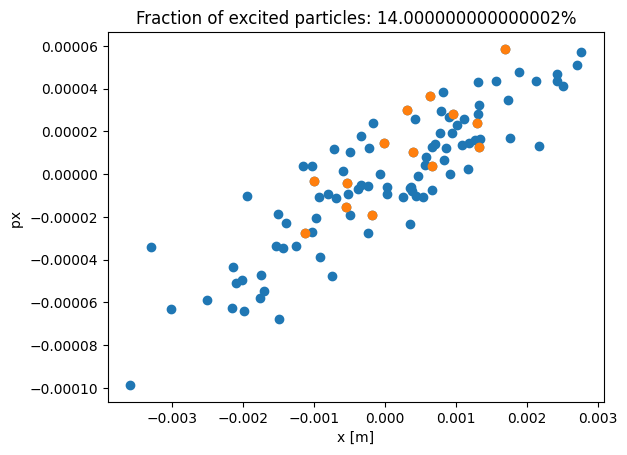

In [15]:
excited=particles.state==2

fraction_excitation = sum(excited)/len(excited)

plt.figure()
plt.title(f'Fraction of excited particles: {fraction_excitation*100}%')

plt.scatter(particles.x,particles.px)
plt.scatter(particles.x[excited],particles.px[excited])
plt.xlabel('x [m]')
plt.ylabel('px ')
plt.show()

In [16]:
(particles.state==2)

array([False,  True, False, False, False, False, False, False,  True,
       False, False,  True, False, False, False, False, False, False,
       False, False,  True, False, False, False,  True, False, False,
       False, False, False,  True,  True, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
        True, False, False, False, False,  True,  True, False,  True,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False,  True, False, False, False, False, False, False,
        True, False, False, False, False, False,  True, False, False,
       False])